# Image colorization with Autoenoder and GANs

# 1) Autoencoder

different autoencoder models are constructed and compared for the image colorization task.

In [ ]:
"""
Colourization of CIFAR-10 Horses via classification.
"""
import argparse
import math
import time

import matplotlib
import matplotlib.pyplot as plt
import numpy as np
import numpy.random as npr
import scipy.misc
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.autograd import Variable


In [ ]:
######################################################################
# Setup working directory
######################################################################
%mkdir -p /content/a3/
%cd /content/a3


/content/a3


In [ ]:
######################################################################
# Helper functions for loading data
######################################################################
# adapted from
# https://github.com/fchollet/keras/blob/master/keras/datasets/cifar10.py

import os
import pickle
import sys
import tarfile

import numpy as np
from PIL import Image
from six.moves.urllib.request import urlretrieve


def get_file(fname, origin, untar=False, extract=False, archive_format="auto", cache_dir="data"):
    datadir = os.path.join(cache_dir)
    if not os.path.exists(datadir):
        os.makedirs(datadir)

    if untar:
        untar_fpath = os.path.join(datadir, fname)
        fpath = untar_fpath + ".tar.gz"
    else:
        fpath = os.path.join(datadir, fname)

    print("File path: %s" % fpath)
    if not os.path.exists(fpath):
        print("Downloading data from", origin)

        error_msg = "URL fetch failure on {}: {} -- {}"
        try:
            try:
                urlretrieve(origin, fpath)
            except URLError as e:
                raise Exception(error_msg.format(origin, e.errno, e.reason))
            except HTTPError as e:
                raise Exception(error_msg.format(origin, e.code, e.msg))
        except (Exception, KeyboardInterrupt) as e:
            if os.path.exists(fpath):
                os.remove(fpath)
            raise

    if untar:
        if not os.path.exists(untar_fpath):
            print("Extracting file.")
            with tarfile.open(fpath) as archive:
                archive.extractall(datadir)
        return untar_fpath

    if extract:
        _extract_archive(fpath, datadir, archive_format)

    return fpath


def load_batch(fpath, label_key="labels"):
    """Internal utility for parsing CIFAR data.
    # Arguments
        fpath: path the file to parse.
        label_key: key for label data in the retrieve
            dictionary.
    # Returns
        A tuple `(data, labels)`.
    """
    f = open(fpath, "rb")
    if sys.version_info < (3,):
        d = pickle.load(f)
    else:
        d = pickle.load(f, encoding="bytes")
        # decode utf8
        d_decoded = {}
        for k, v in d.items():
            d_decoded[k.decode("utf8")] = v
        d = d_decoded
    f.close()
    data = d["data"]
    labels = d[label_key]

    data = data.reshape(data.shape[0], 3, 32, 32)
    return data, labels


def load_cifar10(transpose=False):
    """Loads CIFAR10 dataset.
    # Returns
        Tuple of Numpy arrays: `(x_train, y_train), (x_test, y_test)`.
    """
    dirname = "cifar-10-batches-py"
    origin = "http://www.cs.toronto.edu/~kriz/cifar-10-python.tar.gz"
    path = get_file(dirname, origin=origin, untar=True)

    num_train_samples = 50000

    x_train = np.zeros((num_train_samples, 3, 32, 32), dtype="uint8")
    y_train = np.zeros((num_train_samples,), dtype="uint8")

    for i in range(1, 6):
        fpath = os.path.join(path, "data_batch_" + str(i))
        data, labels = load_batch(fpath)
        x_train[(i - 1) * 10000 : i * 10000, :, :, :] = data
        y_train[(i - 1) * 10000 : i * 10000] = labels

    fpath = os.path.join(path, "test_batch")
    x_test, y_test = load_batch(fpath)

    y_train = np.reshape(y_train, (len(y_train), 1))
    y_test = np.reshape(y_test, (len(y_test), 1))

    if transpose:
        x_train = x_train.transpose(0, 2, 3, 1)
        x_test = x_test.transpose(0, 2, 3, 1)
    return (x_train, y_train), (x_test, y_test)

In [ ]:
# Download CIFAR dataset
m = load_cifar10()

File path: data/cifar-10-batches-py.tar.gz
Extracting file.


In [ ]:
# code to examine the dataset
len(m)

2

In [ ]:
X_train, y_train=m[0][0],m[0][1]
X_test, y_test=m[1][0],m[1][1]

In [ ]:
print(len(X_train),",",len(X_test))

50000 , 10000


In [ ]:
#there is 60000 samples in total split by the ratio of train:test=5:1

In [ ]:
X_train[0].shape

(3, 32, 32)

In [ ]:
y_train[0].shape

(1,)

Preprocess the data to select only images of horses. Learning to generate only horse images will make the task easier.

In [ ]:
# select a single category.
HORSE_CATEGORY = 7

# convert colour images into greyscale
def process(xs, ys, max_pixel=256.0, downsize_input=False):
    """
    Pre-process CIFAR10 images by taking only the horse category,
    shuffling, and have colour values be bound between 0 and 1

    Args:
      xs: the colour RGB pixel values
      ys: the category labels
      max_pixel: maximum pixel value in the original data
    Returns:
      xs: value normalized and shuffled colour images
      grey: greyscale images, also normalized so values are between 0 and 1
    """
    xs = xs / max_pixel
    xs = xs[np.where(ys == HORSE_CATEGORY)[0], :, :, :]
    npr.shuffle(xs)

    grey = np.mean(xs, axis=1, keepdims=True)

    if downsize_input:
        downsize_module = nn.Sequential(
            nn.AvgPool2d(2), #normalization
            nn.AvgPool2d(2),
            nn.Upsample(scale_factor=2),
            nn.Upsample(scale_factor=2),
        )
        xs_downsized = downsize_module.forward(torch.from_numpy(xs).float())
        xs_downsized = xs_downsized.data.numpy()
        return (xs, xs_downsized)
    else:
        return (xs, grey)


In [ ]:
#x_train, grey_train=process(X_train,y_train, max_pixel=256.0, downsize_input=False)

In [ ]:
#x_test, grey_test=process(X_test,y_test, max_pixel=256.0, downsize_input=False)

In [ ]:
#grey_train.shape

In [ ]:
#x_train.shape

In [ ]:
#x_test.shape

In [ ]:
# dataloader for batching samples

def get_batch(x, y, batch_size):
    """
    Generated that yields batches of data

    Args:
      x: input values
      y: output values
      batch_size: size of each batch
    Yields:
      batch_x: a batch of inputs of size at most batch_size
      batch_y: a batch of outputs of size at most batch_size
    """
    N = np.shape(x)[0]
    assert N == np.shape(y)[0]
    for i in range(0, N, batch_size):
        batch_x = x[i : i + batch_size, :, :, :]
        batch_y = y[i : i + batch_size, :, :, :]
        yield (batch_x, batch_y)

In [ ]:
# code to load different batches of horse dataset

print("Loading data...")
(x_train, y_train), (x_test, y_test) = load_cifar10()

print("Transforming data...")
train_rgb, train_grey = process(x_train, y_train)
test_rgb, test_grey = process(x_test, y_test)


Loading data...
File path: data/cifar-10-batches-py.tar.gz
Transforming data...


In [ ]:
# shape of data and labels before selection
print(x_train.shape, y_train.shape)

(50000, 3, 32, 32) (50000, 1)


In [ ]:
# shape of training data
print('Training Data: ', train_rgb.shape, train_grey.shape)
# shape of testing data
print('Testing Data: ', test_rgb.shape, test_grey.shape)

Training Data:  (5000, 3, 32, 32) (5000, 1, 32, 32)
Testing Data:  (1000, 3, 32, 32) (1000, 1, 32, 32)


Load Batches

In [ ]:
# obtain batches of images
xs, ys = next(iter(get_batch(train_grey, train_rgb, 10)))
print(xs.shape, ys.shape)

(10, 1, 32, 32) (10, 3, 32, 32)


Visualization

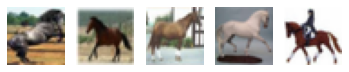

In [ ]:
# visualize 5 train/test images
# Visualization of train images
import matplotlib.pyplot as plt
x_0,y_0 = next(iter(get_batch(train_grey, train_rgb, 5)))
x_t,y_t = next(iter(get_batch(test_grey, test_rgb, 5)))
for i in range(5):
    image = y_0[i]
    # place the color channel at the end, instead of at the beginning
    img = np.transpose(image, [1,2,0])
    plt.subplot(1, 5, i+1)
    plt.axis('off')
    plt.imshow(img)

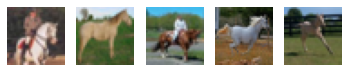

In [ ]:
#Visualization of test images
for i in range(5):
    image_1=y_t[i]
    img_1 = np.transpose(image_1, [1,2,0])
    plt.subplot(1, 5, i+1)
    plt.axis('off')
    plt.imshow(img_1)

Regression Architecture

In [ ]:
class RegressionCNN(nn.Module):
    def __init__(self, kernel, num_filters):
        # first call parent's initialization function
        super().__init__()
        padding = kernel // 2

        self.downconv1 = nn.Sequential(
            nn.Conv2d(1, num_filters, kernel_size=kernel, padding=padding),
            nn.BatchNorm2d(num_filters),
            nn.ReLU(),
            nn.MaxPool2d(2),)
        self.downconv2 = nn.Sequential(
            nn.Conv2d(num_filters, num_filters*2, kernel_size=kernel, padding=padding),
            nn.BatchNorm2d(num_filters*2),
            nn.ReLU(),
            nn.MaxPool2d(2),)

        self.rfconv = nn.Sequential(
            nn.Conv2d(num_filters*2, num_filters*2, kernel_size=kernel, padding=padding),
            nn.BatchNorm2d(num_filters*2),
            nn.ReLU())

        self.upconv1 = nn.Sequential(
            nn.Conv2d(num_filters*2, num_filters, kernel_size=kernel, padding=padding),
            nn.BatchNorm2d(num_filters),
            nn.ReLU(),
            nn.Upsample(scale_factor=2),)
        self.upconv2 = nn.Sequential(
            nn.Conv2d(num_filters, 3, kernel_size=kernel, padding=padding),
            nn.BatchNorm2d(3),
            nn.ReLU(),
            nn.Upsample(scale_factor=2),)
        self.finalconv = nn.Conv2d(3, 3, kernel_size=kernel, padding=padding)

    def forward(self, x):
        out = self.downconv1(x)
        out = self.downconv2(out)
        out = self.rfconv(out)
        out = self.upconv1(out)
        out = self.upconv2(out)
        out = self.finalconv(out)
        return out

Training code

In [ ]:
class AttrDict(dict):
    def __init__(self, *args, **kwargs):
        super(AttrDict, self).__init__(*args, **kwargs)
        self.__dict__ = self

def get_torch_vars(xs, ys, gpu=False):
    """
    Helper function to convert numpy arrays to pytorch tensors.
    If GPU is used, move the tensors to GPU.

    Args:
      xs (float numpy tenosor): greyscale input
      ys (int numpy tenosor): rgb as labels
      gpu (bool): whether to move pytorch tensor to GPU
    Returns:
      Variable(xs), Variable(ys)
    """
    xs = torch.from_numpy(xs).float()
    ys = torch.from_numpy(ys).float()
    if gpu:
        xs = xs.cuda()
        ys = ys.cuda()
    return Variable(xs), Variable(ys)
def evaluate(args,gen,test_grey, test_rgb):
    total_loss = 0.0
    total_accuracy = 0.0
    total_epoch = 0
    criterion = nn.MSELoss()
    for i, (xs, ys) in enumerate(get_batch(test_grey, test_rgb, args.batch_size)):
      images, labels = get_torch_vars(xs, ys, args.gpu)
        
      output = gen(images)
      loss = criterion(output, labels)
      
      total_accuracy += 1-torch.sum((labels - output) ** 2)/torch.sum((labels - torch.mean(labels)) ** 2)
      total_loss += loss.item()
    acc = float(total_accuracy) / (i+1)
    loss = float(total_loss) / (i + 1)
    return acc, loss

def train(args, gen=None):

    # Numpy random seed
    npr.seed(args.seed)

    # Save directory
    save_dir = "outputs/" + args.experiment_name

    # LOAD THE MODEL
    if gen is None:
        Net = globals()[args.model]
        gen = Net(args.kernel, args.num_filters)

    # LOSS FUNCTION
    criterion = nn.MSELoss()
    optimizer = torch.optim.Adam(gen.parameters(), lr=args.learn_rate)

    # DATA
    print("Loading data...")
    (x_train, y_train), (x_test, y_test) = load_cifar10()

    print("Transforming data...")
    train_rgb, train_grey = process(x_train, y_train, downsize_input=args.downsize_input)
    test_rgb, test_grey = process(x_test, y_test, downsize_input=args.downsize_input)

    # Create the outputs folder if not created already
    if not os.path.exists(save_dir):
        os.makedirs(save_dir)

    print("Beginning training ...")
    if args.gpu:
        gen.cuda()
    start = time.time()

    train_losses = []
    valid_losses = []
    valid_accs = []
    for epoch in range(args.epochs):
        # Train the Model
        gen.train()  # Change model to 'train' mode
        losses = []
        for i, (xs, ys) in enumerate(get_batch(train_grey, train_rgb, args.batch_size)):
            images, labels = get_torch_vars(xs, ys, args.gpu)
            # Forward + Backward + Optimize
            optimizer.zero_grad()
            outputs = gen(images)

            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()
            losses.append(loss.data.item())
  
        print(epoch, loss.cpu().detach())
        if args.plot:
          visual(images, labels, outputs, args.gpu, 1)
    
    return gen

def train_val(args, gen=None):

    # Numpy random seed
    npr.seed(args.seed)

    # Save directory
    save_dir = "outputs/" + args.experiment_name

    # LOAD THE MODEL
    if gen is None:
        Net = globals()[args.model]
        gen = Net(args.kernel, args.num_filters)

    # LOSS FUNCTION
    criterion = nn.MSELoss()
    optimizer = torch.optim.Adam(gen.parameters(), lr=args.learn_rate)

    # DATA
    print("Loading data...")
    (x_train, y_train), (x_test, y_test) = load_cifar10()

    print("Transforming data...")
    train_rgb, train_grey = process(x_train, y_train, downsize_input=args.downsize_input)
    test_rgb, test_grey = process(x_test, y_test, downsize_input=args.downsize_input)

    # Create the outputs folder if not created already
    if not os.path.exists(save_dir):
        os.makedirs(save_dir)

    print("Beginning training ...")
    if args.gpu:
        gen.cuda()
    start = time.time()

    train_losses = []
    valid_losses = []
    valid_accs = []
    for epoch in range(args.epochs):
        # Train the Model
        gen.train()  # Change model to 'train' mode
        losses = []
        for i, (xs, ys) in enumerate(get_batch(train_grey, train_rgb, args.batch_size)):
            images, labels = get_torch_vars(xs, ys, args.gpu)

            optimizer.zero_grad()
            outputs = gen(images)

            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()
            losses.append(loss.data.item())
        train_losses.append(np.sum(losses)/(i+1))
        acc, val_loss=evaluate(args,gen,test_grey, test_rgb)
        valid_accs.append(acc)
        valid_losses.append(val_loss)
        print(epoch, loss.cpu().detach())
        if args.plot:
          visual(images, labels, outputs, args.gpu, 1)
    
    return gen, train_losses, valid_losses, valid_accs

Training visualization code

In [ ]:
# visualize 5 train/test images
def visual(img_grey, img_real, img_fake, gpu = 0, flag_torch = 0):

  if gpu:
    img_grey = img_grey.cpu().detach()
    img_real = img_real.cpu().detach()
    img_fake = img_fake.cpu().detach()

  if flag_torch:
    img_grey = img_grey.numpy()
    img_real = img_real.numpy()
    img_fake = img_fake.numpy()

  if flag_torch == 2:
    img_real = np.transpose(img_real[:, :, :, :, :], [0, 4, 2, 3, 1]).squeeze()
    img_fake = np.transpose(img_fake[:, :, :, :, :], [0, 4, 2, 3, 1]).squeeze()

  #correct image structure
  img_grey = np.transpose(img_grey[:5, :, :, :], [0, 2, 3, 1]).squeeze()
  img_real = np.transpose(img_real[:5, :, :, :], [0, 2, 3, 1])
  img_fake = np.transpose(img_fake[:5, :, :, :], [0, 2, 3, 1])

  for i in range(5):
      ax = plt.subplot(3, 5, i + 1)
      ax.imshow(img_grey[i], cmap='gray')
      ax.axis("off")
      ax = plt.subplot(3, 5, i + 1 + 5)
      ax.imshow(img_real[i])
      ax.axis("off")
      ax = plt.subplot(3, 5, i + 1 + 10)
      ax.imshow(img_fake[i])
      ax.axis("off")
  plt.show()

Main training loop for regression CNN

Loading data...
File path: data/cifar-10-batches-py.tar.gz
Transforming data...
Beginning training ...


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


0 tensor(0.0668)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


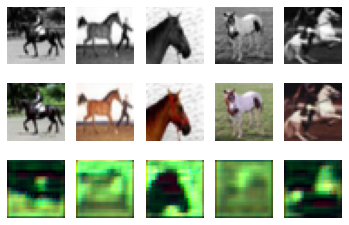

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1 tensor(0.0213)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


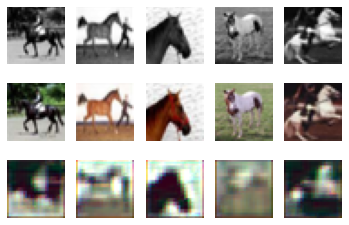

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2 tensor(0.0168)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


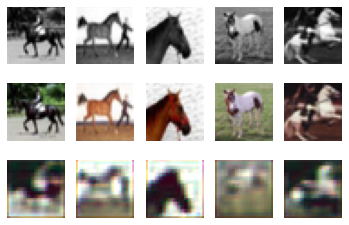

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3 tensor(0.0151)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


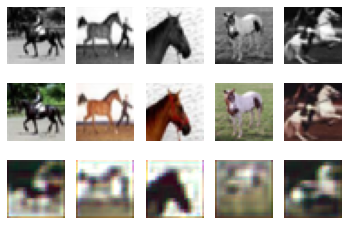

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


4 tensor(0.0140)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


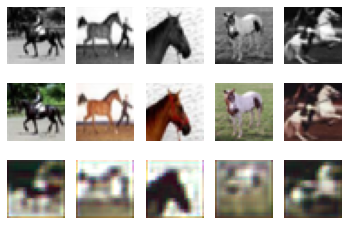

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


5 tensor(0.0133)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


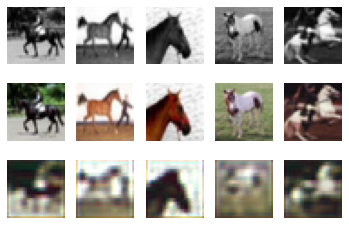

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


6 tensor(0.0127)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


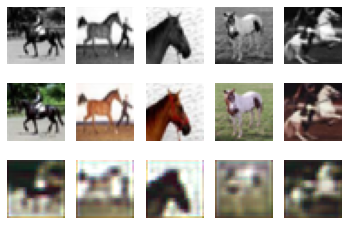

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


7 tensor(0.0122)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


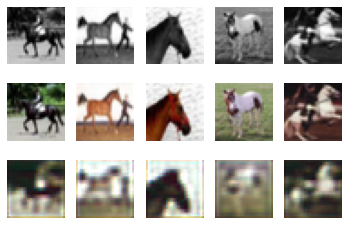

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


8 tensor(0.0118)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


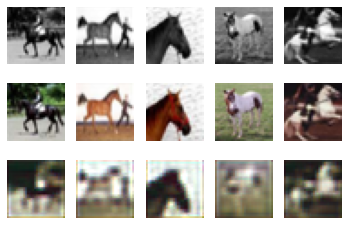

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


9 tensor(0.0114)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


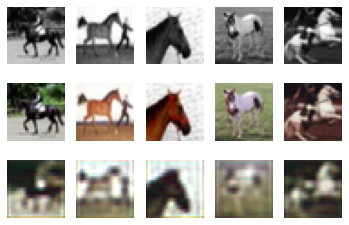

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


10 tensor(0.0111)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


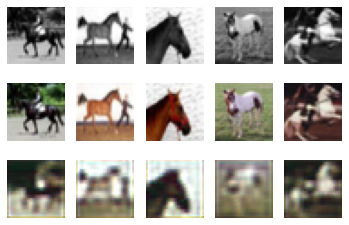

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


11 tensor(0.0109)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


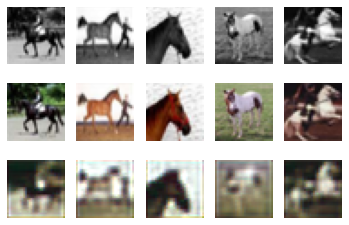

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


12 tensor(0.0106)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


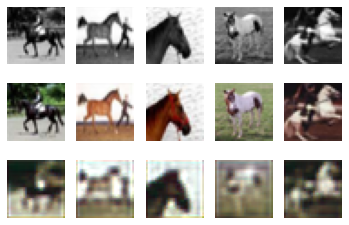

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


13 tensor(0.0104)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


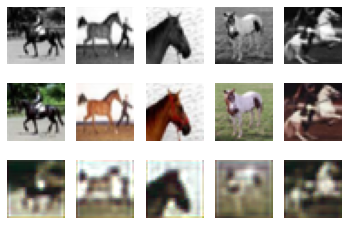

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


14 tensor(0.0102)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


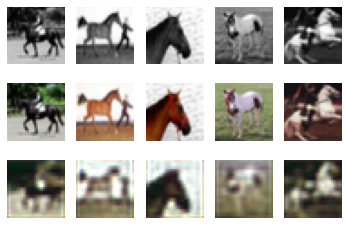

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


15 tensor(0.0101)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


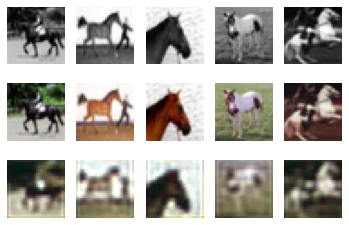

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


16 tensor(0.0099)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


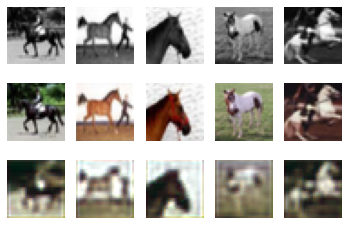

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


17 tensor(0.0098)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


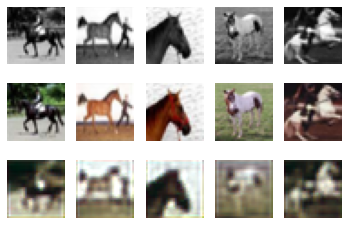

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


18 tensor(0.0096)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


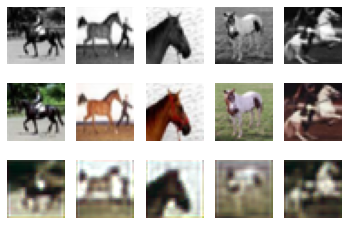

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


19 tensor(0.0095)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


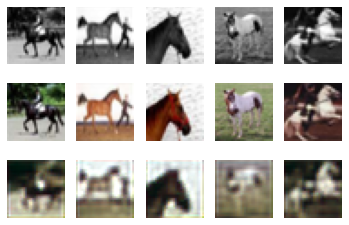

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


20 tensor(0.0094)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


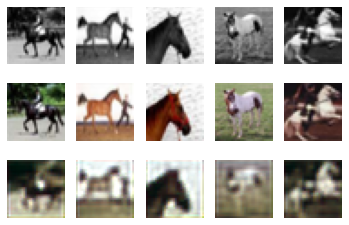

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


21 tensor(0.0093)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


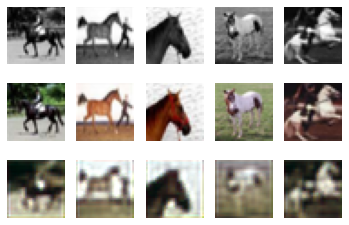

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


22 tensor(0.0092)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


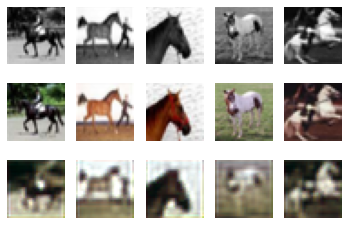

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


23 tensor(0.0091)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


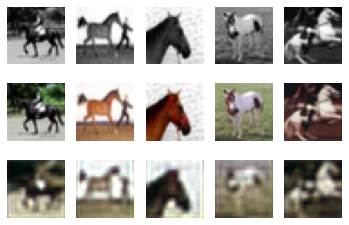

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


24 tensor(0.0090)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


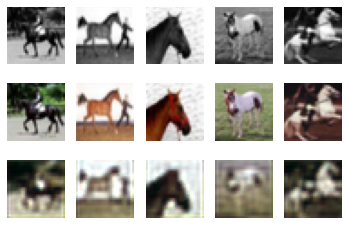

In [ ]:
#Main training loop for CNN
args = AttrDict()
args_dict = {
    "gpu": True,
    "valid": False,
    "checkpoint": "",
    "colours": "./data/colours/colour_kmeans24_cat7.npy",
    "model": "RegressionCNN",
    "kernel": 3,
    "num_filters": 32,
    'learn_rate':0.001, 
    "batch_size": 100,
    "epochs": 25,
    "seed": 0,
    "plot": True,
    "experiment_name": "colourization_cnn",
    "visualize": False,
    "downsize_input": False,
}

args.update(args_dict)
cnn = train(args)

A couple of new models are re-trained using a different number of training epochs. 

In [ ]:
args = AttrDict()
args_dict = {
    "gpu": True,
    "valid": False,
    "checkpoint": "",
    "colours": "./data/colours/colour_kmeans24_cat7.npy",
    "model": "RegressionCNN",
    "kernel": 3,
    "num_filters": 32,
    'learn_rate':0.001, 
    "batch_size": 100,
    "epochs": 15,
    "seed": 0,
    "plot": True,
    "experiment_name": "colourization_cnn",
    "visualize": False,
    "downsize_input": False,
}

args.update(args_dict)
cnn = train(args)

In [ ]:
args = AttrDict()
args_dict = {
    "gpu": True,
    "valid": False,
    "checkpoint": "",
    "colours": "./data/colours/colour_kmeans24_cat7.npy",
    "model": "RegressionCNN",
    "kernel": 3,
    "num_filters": 32,
    'learn_rate':0.001, 
    "batch_size": 100,
    "epochs": 50,
    "seed": 0,
    "plot": True,
    "experiment_name": "colourization_cnn",
    "visualize": False,
    "downsize_input": False,
}

args.update(args_dict)
cnn = train(args)

by increasing the number of epochs the training loss at the end epoch would be lowered and the colored images would be able to have higher quality, which is reflected in the less pixelated output pictures. 

While by decreasing the number of epochs the training loss at the end epoch is comparatively higher, and the output image quality is accordingly lowered and less clear.

Implement UNET

In [ ]:
class UNet(nn.Module):
    def __init__(self, kernel, num_filters, num_colours=3, num_in_channels=1):
        super().__init__()

        # parameters
        stride = 2
        padding = kernel // 2
        output_padding = 1
        self.conv1=nn.Conv2d(1, num_filters, kernel, stride=2, padding=padding)
        self.conv2=nn.Conv2d(num_filters, num_filters*2, kernel, stride=2, padding=padding)
        self.conv3=nn.Conv2d(num_filters*2, num_filters*4, kernel, stride=2, padding=padding)
        self.conv=nn.Conv2d(num_filters*4, num_filters*2,1, stride=1, padding=0)
        self.conv0=nn.Conv2d(num_filters*2, num_filters,1, stride=1, padding=0)
        self.conv4=nn.ConvTranspose2d(num_filters*4, num_filters*2, kernel,stride=2, padding=padding, output_padding = 1)
        self.conv5=nn.ConvTranspose2d(num_filters*2, num_filters, kernel, stride=2, padding=padding, output_padding = 1)
        self.conv6=nn.ConvTranspose2d(num_filters, 3, kernel, stride=2, padding=padding, output_padding = 1)

    def forward(self, x):
        
        out1 = F.relu(self.conv1(x)) #32, 16,16
        out2 = F.relu(self.conv2(out1))
        
        out3 = F.relu(self.conv3(out2)) #bottle-neck 128,4,4
        out4 = F.relu(self.conv4(out3)) #64,8,8

        concat1 = torch.cat((out4,out2), dim=1) # 128,8,8
        out5_skip=F.relu(self.conv(concat1)) #64,8,8
        out5 = F.relu(self.conv5(out5_skip)) #32,16,16
        concat2 = torch.cat((out5,out1), dim=1)
        out6_skip=F.relu(self.conv0(concat2))
        out6 = self.conv6(out6_skip)
        out=F.sigmoid(out6)
        
        return out

In [ ]:
#run the previous CNN again with added val loss and accuracy function
args = AttrDict()
args_dict = {
    "gpu": True,
    "valid": False,
    "checkpoint": "",
    "colours": "./data/colours/colour_kmeans24_cat7.npy",
    "model": "RegressionCNN",
    "kernel": 3,
    "num_filters": 32,
    'learn_rate':0.001, 
    "batch_size": 100,
    "epochs": 25,
    "seed": 0,
    "plot": True,
    "experiment_name": "colourization_cnn",
    "visualize": False,
    "downsize_input": False,
}
args.update(args_dict)
cnn, train_l, val_l, val_acc = train_val(args)

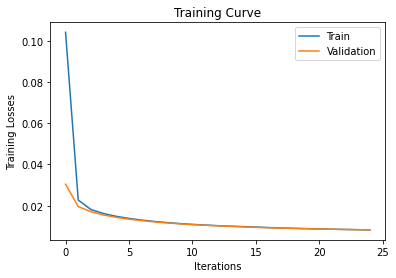

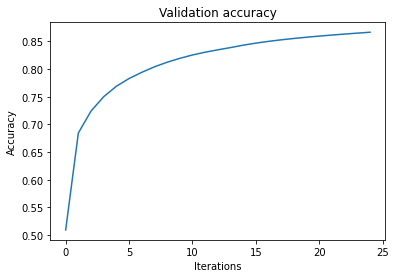

In [ ]:
plt.title("Training Curve")
plt.plot(np.arange(len(train_l)), train_l, label="Train")
plt.plot(np.arange(len(val_l)), val_l, label="Validation")
plt.xlabel("Iterations")
plt.ylabel("Training Losses")
plt.legend(loc='best')
plt.show()

plt.title("Validation accuracy")
plt.plot(np.arange(len(val_acc)), val_acc)
plt.xlabel("Iterations")
plt.ylabel("Accuracy")
plt.show()

In [ ]:
# Main training loop for UNet and get the validation loss and accuracy
args = AttrDict()
args_dict = {
    "gpu": True,
    "valid": False,
    "checkpoint": "",
    "colours": "./data/colours/colour_kmeans24_cat7.npy",
    "model": "UNet",
    "kernel": 3,
    "num_filters": 32,
    'learn_rate':0.001, 
    "batch_size": 100,
    "epochs": 25,
    "seed": 0,
    "plot": True,
    "experiment_name": "colourization_cnn",
    "visualize": False,
    "downsize_input": False,
}
args.update(args_dict)
cnn, train_l, val_l, val_acc = train_val(args)

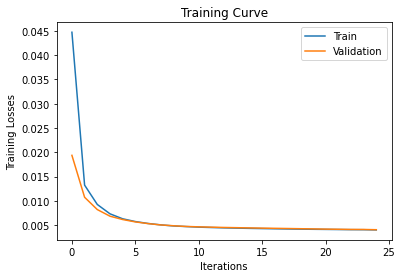

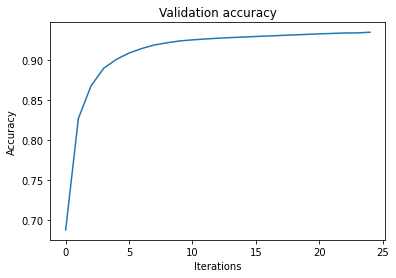

In [ ]:
plt.title("Training Curve")
plt.plot(np.arange(len(train_l)), train_l, label="Train")
plt.plot(np.arange(len(val_l)), val_l, label="Validation")
plt.xlabel("Iterations")
plt.ylabel("Training Losses")
plt.legend(loc='best')
plt.show()

plt.title("Validation accuracy")
plt.plot(np.arange(len(val_acc)), val_acc)
plt.xlabel("Iterations")
plt.ylabel("Accuracy")
plt.show()

As it can be seen, skip connection model improves the validation loss and accuracy, as well as the overall quality of the output images.

Skip connections mitigate the problem of vanishing gradients and accuracy saturation, therefore allowing the model to train as desired.

A few more "UNet" models are re-trained using different mini batch sizes with a fixed number of epochs.

In [ ]:
args = AttrDict()
args_dict = {
    "gpu": True,
    "valid": False,
    "checkpoint": "",
    "colours": "./data/colours/colour_kmeans24_cat7.npy",
    "model": "UNet",
    "kernel": 3,
    "num_filters": 32,
    'learn_rate':0.001, 
    "batch_size": 50,
    "epochs": 25,
    "seed": 0,
    "plot": True,
    "experiment_name": "colourization_cnn",
    "visualize": False,
    "downsize_input": False,
}
args.update(args_dict)
cnn, train_l, val_l, val_acc = train_val(args)

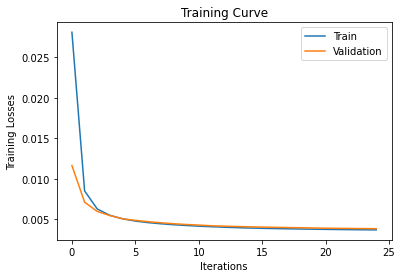

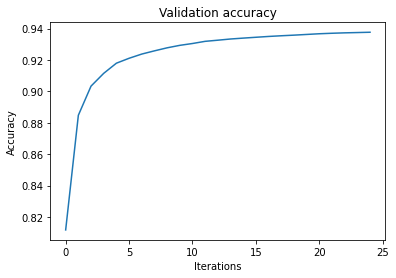

In [ ]:
plt.title("Training Curve")
plt.plot(np.arange(len(train_l)), train_l, label="Train")
plt.plot(np.arange(len(val_l)), val_l, label="Validation")
plt.xlabel("Iterations")
plt.ylabel("Training Losses")
plt.legend(loc='best')
plt.show()

plt.title("Validation accuracy")
plt.plot(np.arange(len(val_acc)), val_acc)
plt.xlabel("Iterations")
plt.ylabel("Accuracy")
plt.show()

In [ ]:
args = AttrDict()
args_dict = {
    "gpu": True,
    "valid": False,
    "checkpoint": "",
    "colours": "./data/colours/colour_kmeans24_cat7.npy",
    "model": "UNet",
    "kernel": 3,
    "num_filters": 32,
    'learn_rate':0.001, 
    "batch_size": 300,
    "epochs": 25,
    "seed": 0,
    "plot": True,
    "experiment_name": "colourization_cnn",
    "visualize": False,
    "downsize_input": False,
}
args.update(args_dict)
cnn, train_l, val_l, val_acc = train_val(args)

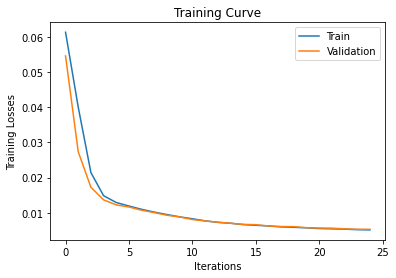

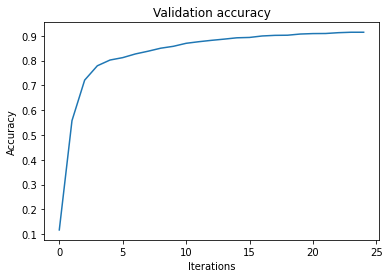

In [ ]:
plt.title("Training Curve")
plt.plot(np.arange(len(train_l)), train_l, label="Train")
plt.plot(np.arange(len(val_l)), val_l, label="Validation")
plt.xlabel("Iterations")
plt.ylabel("Training Losses")
plt.legend(loc='best')
plt.show()

plt.title("Validation accuracy")
plt.plot(np.arange(len(val_acc)), val_acc)
plt.xlabel("Iterations")
plt.ylabel("Accuracy")
plt.show()

Smaller batch size appears to improve the validation accuracy and the colored image quality, it also lowers the training and validation losses.

# 2) Conditional GAN

In [ ]:
class Generator(nn.Module):
    def __init__(self, kernel, num_filters, num_colours=3, num_in_channels=1):
        super().__init__()
        # parameters
        stride = 2
        padding = kernel // 2
        output_padding = 1
 
        self.conv1=nn.Conv2d(1, num_filters, kernel, stride=2, padding=padding)
        self.conv2=nn.Conv2d(num_filters, num_filters*2, kernel, stride=2, padding=padding)
        self.conv3=nn.Conv2d(num_filters*2, num_filters*4, kernel, stride=2, padding=padding)
        self.conv=nn.Conv2d(num_filters*4, num_filters*2,1, stride=1, padding=0)
        self.conv0=nn.Conv2d(num_filters*2, num_filters,1, stride=1, padding=0)
        self.conv4=nn.ConvTranspose2d(num_filters*4, num_filters*2, kernel,stride=2, padding=padding, output_padding = 1)
        self.conv5=nn.ConvTranspose2d(num_filters*2, num_filters, kernel, stride=2, padding=padding, output_padding = 1)
        self.conv6=nn.ConvTranspose2d(num_filters, 3, kernel, stride=2, padding=padding, output_padding = 1)
        self.sig=nn.Sigmoid()

    def forward(self, x):

        out1 = F.relu(self.conv1(x)) #32, 16,16
        out2 = F.relu(self.conv2(out1))
        
        out3 = F.relu(self.conv3(out2)) #bottle-neck 128,4,4
        out4 = F.relu(self.conv4(out3)) #64,8,8

        concat1 = torch.cat((out4,out2), dim=1) # 128,8,8
        out5_skip=F.relu(self.conv(concat1)) #64,8,8
        out5 = F.relu(self.conv5(out5_skip)) #32,16,16
        concat2 = torch.cat((out5,out1), dim=1)
        out6_skip=F.relu(self.conv0(concat2))
        out6 = self.conv6(out6_skip)
  
        out=self.sig(out6)   #(0, 1)       

        return out

In [ ]:
def G_test(args, gen=None):

    # LOAD THE MODEL
    if gen is None:
        Net = globals()[args.model]
        gen = Net(args.kernel, args.num_filters)

    # LOSS FUNCTION
    criterion = nn.MSELoss()
    optimizer = torch.optim.Adam(gen.parameters(), lr=args.learn_rate)

    # DATA
    print("Loading data...")
    (x_train, y_train), (x_test, y_test) = load_cifar10()

    print("Transforming data...")
    train_rgb, train_grey = process(x_train, y_train, downsize_input=args.downsize_input)
    #test_rgb, test_grey = process(x_test, y_test, downsize_input=args.downsize_input)
    train_rgb=train_rgb[:5,:,:,:]
    train_grey = train_grey[:5,:,:,:]

    print("Beginning training ...")
    if args.gpu:
        gen.cuda()
    start = time.time()

    train_losses = []
    valid_losses = []
    valid_accs = []
    for epoch in range(args.epochs):
        # Train the Model
        gen.train()  # Change model to 'train' mode
        losses = []
        for i, (xs, ys) in enumerate(get_batch(train_grey, train_rgb, args.batch_size)):
            images, labels = get_torch_vars(xs, ys, args.gpu)
            # Forward + Backward + Optimize
            optimizer.zero_grad()
            outputs = gen(images)
            
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()
            losses.append(loss.data.item())
  
        print(epoch, loss.cpu().detach())
        if args.plot:
          visual(images, labels, outputs, args.gpu, 1)
    
    return gen, outputs, images, labels

Loading data...
File path: data/cifar-10-batches-py.tar.gz
Transforming data...
Beginning training ...
0 tensor(0.0656)


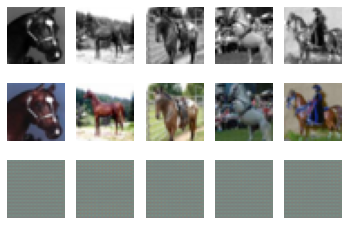

1 tensor(0.0653)


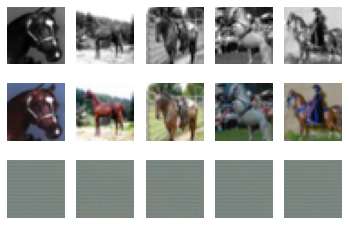

2 tensor(0.0649)


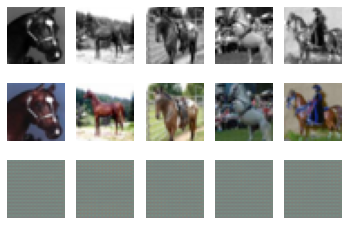

3 tensor(0.0645)


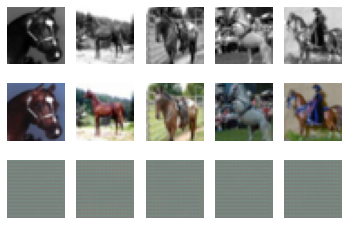

4 tensor(0.0641)


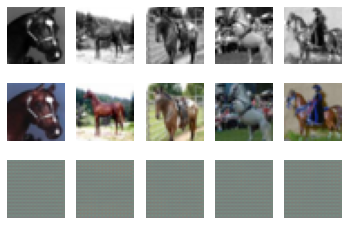

5 tensor(0.0637)


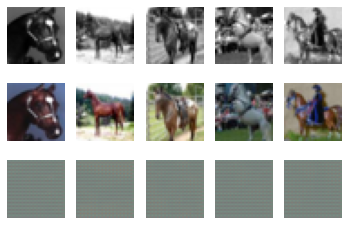

6 tensor(0.0633)


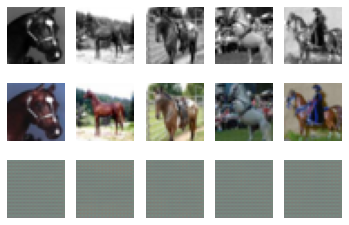

7 tensor(0.0629)


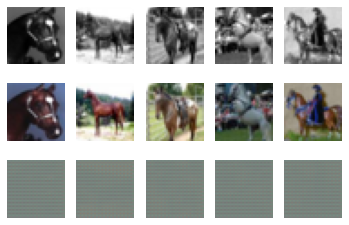

8 tensor(0.0624)


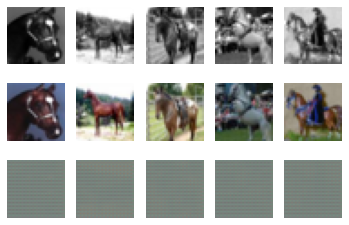

9 tensor(0.0619)


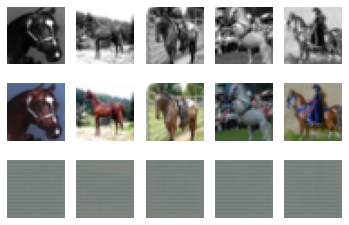

10 tensor(0.0614)


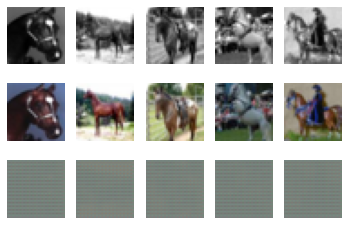

11 tensor(0.0607)


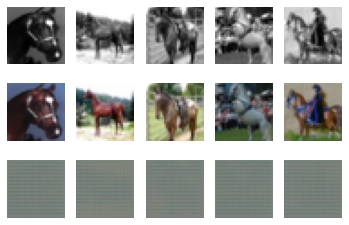

12 tensor(0.0598)


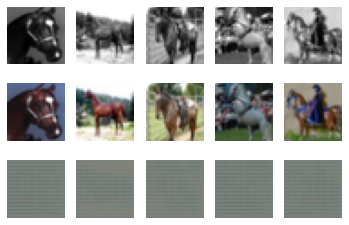

13 tensor(0.0588)


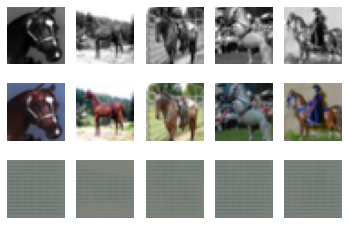

14 tensor(0.0575)


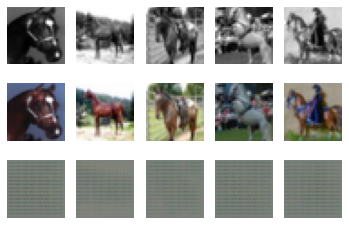

15 tensor(0.0559)


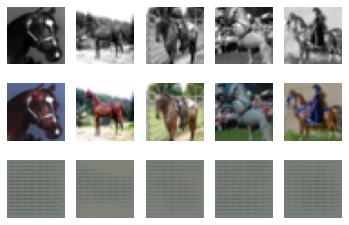

16 tensor(0.0540)


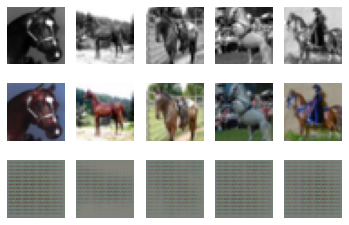

17 tensor(0.0519)


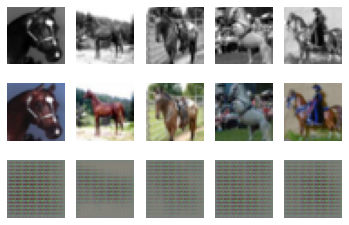

18 tensor(0.0497)


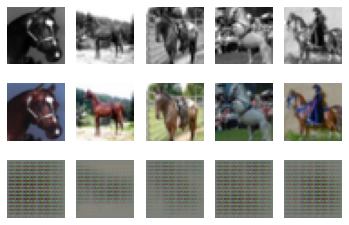

19 tensor(0.0476)


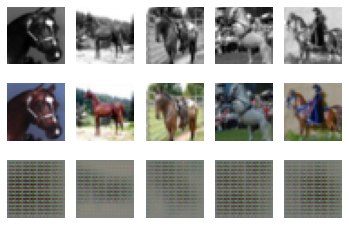

20 tensor(0.0454)


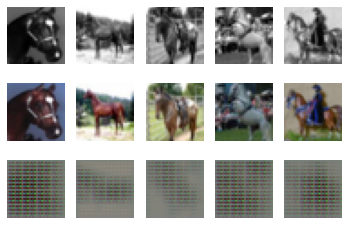

21 tensor(0.0433)


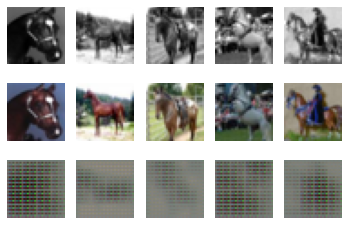

22 tensor(0.0417)


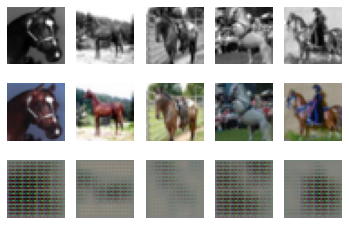

23 tensor(0.0402)


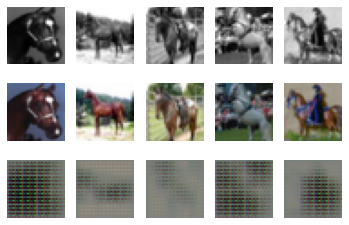

24 tensor(0.0389)


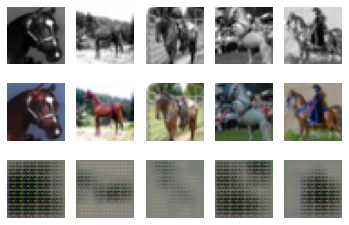

In [ ]:
#test generator architecture
args = AttrDict()
args_dict = {
    "gpu": True,
    "valid": False,
    "checkpoint": "",
    "colours": "./data/colours/colour_kmeans24_cat7.npy",
    "model": "Generator",
    "kernel": 3,
    "num_filters": 32,
    'learn_rate':0.001, 
    "batch_size": 5,
    "epochs": 25,
    "seed": 0,
    "plot": True,
    "experiment_name": "colourization_cnn",
    "visualize": False,
    "downsize_input": False,
}

args.update(args_dict)
cnn, fake_images, grey, rgb = G_test(args)

In [ ]:
class Discriminator(nn.Module):
    def __init__(self, kernel, num_filters, num_colours=3, num_in_channels=4):
        super().__init__()
        
        #parameters
        #stride = 2
        padding = kernel // 2
        #output_padding = 1
        self.cov1 = nn.Conv2d(4, num_filters, kernel, stride=2, padding=padding) #34x34x4 - 16x16x32 
        self.cov2 = nn.Conv2d(num_filters, num_filters*2, kernel, stride=2, padding=padding) #8x8x64
        self.cov3 = nn.Conv2d(num_filters*2, num_filters*4, kernel, stride=2, padding=padding)
        #self.cov4 = nn.Conv2d(num_filters*4, num_filters*8, kernel, stride=2, padding=padding) 
        self.fc1 = nn.Linear(4*4*num_filters*4, 512)
        #self.fc2 = nn.Linear(1024, 512)
        self.fc3 = nn.Linear(512, 256)
        self.fc4 = nn.Linear(256, 1)
        self.lr=nn.LeakyReLU(0.2, inplace=True)
        self.do=nn.Dropout(0.3)
        self.sig=nn.Sigmoid()

    def forward(self, x, img_greyscale):
            
        out = torch.cat((x, img_greyscale),1) 
        out = self.do(self.lr(self.cov1(out)))
        out = self.do(self.lr(self.cov2(out)))
        out = self.do(self.lr(self.cov3(out)))
        #out = self.do(self.lr(self.cov4(out)))
        out = out.view(-1, 2048) 
        out = self.do(self.lr(self.fc1(out)))
        #out = self.do(self.lr(self.fc2(out)))
        out = self.do(self.lr(self.fc3(out)))
        out = self.sig(self.fc4(out))

        return out.squeeze()

In [ ]:
def D_test(args, fake_images, grey, rgb, gen=None):

    # LOAD THE MODEL
    if gen is None:
        Net = globals()[args.model]
        gen = Net(args.kernel, args.num_filters)

    # LOSS FUNCTION
    criterion = nn.BCELoss()
    optimizer = torch.optim.Adam(gen.parameters(), lr=args.learn_rate)

    print("Beginning training ...")
    if args.gpu:
        gen.cuda()
    start = time.time()

    train_losses = []
    valid_losses = []
    valid_accs = []
    for epoch in range(args.epochs):
        # Train the Model
        gen.train()  # Change model to 'train' mode
        #generator.train()
        losses = []
            
        # Forward + Backward + Optimize
        optimizer.zero_grad()
        outputs_real = gen(rgb, grey)
        loss_real = criterion(outputs_real, Variable(torch.ones(args.batch_size)).cuda())

            #_,fake_images = G_test(args,gen=cnn)
        outputs_fake = gen(fake_images, grey)
        loss_fake = criterion(outputs_fake, Variable(torch.zeros(args.batch_size)).cuda())

        loss=loss_real+loss_fake

        #    loss.backward()
         #   optimizer.step()
          #  losses.append(loss.data.item())
  
        print(epoch, loss.cpu().detach())
    print(loss_fake)
    print(loss_real)
    
    return gen

In [ ]:
# test discriminator architecture
args = AttrDict()
args_dict = {
    "gpu": True,
    "valid": False,
    "checkpoint": "",
    "colours": "./data/colours/colour_kmeans24_cat7.npy",
    "model": "Discriminator",
    "kernel": 3,
    "num_filters": 32,
    'learn_rate':0.001, 
    "batch_size": 5,
    "epochs": 1,
    "seed": 0,
    "plot": False,
    "experiment_name": "colourization_cnn",
    "visualize": False,
    "downsize_input": False,
}

args.update(args_dict)
D_m = D_test(args,fake_images, grey, rgb,)

Beginning training ...
0 tensor(1.3881)
tensor(0.7283, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.6599, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)


In [ ]:
class AttrDict(dict):
    def __init__(self, *args, **kwargs):
        super(AttrDict, self).__init__(*args, **kwargs)
        self.__dict__ = self

def get_torch_vars(xs, ys, gpu=False):

    xs = torch.from_numpy(xs).float()
    ys = torch.from_numpy(ys).float() #--> ADDED for cGAN
    if gpu:
        xs = xs.cuda()
        ys = ys.cuda()
    return Variable(xs), Variable(ys)

def train(args, cnn=None):
    # Set the maximum number of threads to prevent crash in Teaching Labs

    torch.set_num_threads(5)
    npr.seed(args.seed)

    save_dir = "outputs/" + args.experiment_name

    # LOAD THE COLOURS CATEGORIES

    # INPUT CHANNEL
    num_in_channels = 1 if not args.downsize_input else 3
    # LOAD THE MODEL
    if cnn is None:
        Net = globals()[args.model]
        cnn = Net(args.kernel, args.num_filters)
        discriminator = Discriminator(args.kernel, args.num_filters)

    # LOSS FUNCTION

    criterion = nn.BCELoss()
    d_optimizer = torch.optim.Adam(discriminator.parameters(), lr=1e-4)
    g_optimizer = torch.optim.Adam(cnn.parameters(), lr=1e-4)

    # DATA
    print("Loading data...")
    (x_train, y_train), (x_test, y_test) = load_cifar10()

    print("Transforming data...")
    train_rgb, train_grey = process(x_train, y_train, downsize_input=args.downsize_input)
    test_rgb, test_grey = process(x_test, y_test, downsize_input=args.downsize_input)

    # Create the outputs folder if not created already
    if not os.path.exists(save_dir):
        os.makedirs(save_dir)

    print("Beginning training ...")
    if args.gpu:
        cnn.cuda()
        discriminator.cuda()
    start = time.time()

    train_losses = []
    valid_losses = []
    valid_accs = []
    for epoch in range(args.epochs):
        # Train the Model
        cnn.train()
        discriminator.train()
        losses = []
 
        for i, (xs, ys) in enumerate(get_batch(train_grey, train_rgb, args.batch_size)):
            images, labels = get_torch_vars(xs, ys, args.gpu)

            img_grey = images
            img_real = labels
            batch_size = args.batch_size
            
            #discriminator training
            d_optimizer.zero_grad()         
            fake_images = cnn(img_grey)
           # print(fake_images.shape)
            fake_validity = discriminator(fake_images, img_grey)
            #print(fake_validity.shape)
            fake_loss = criterion(fake_validity, Variable(torch.zeros(args.batch_size)).cuda())
            real_validity = discriminator(img_real, img_grey)
            real_loss = criterion(real_validity, Variable(torch.ones(args.batch_size)).cuda())   
            d_loss = real_loss + fake_loss
            d_loss.backward()
            d_optimizer.step()

            # generator training
            g_optimizer.zero_grad()
            fake_images = cnn(img_grey)
            validity = discriminator(fake_images, img_grey)
            g_loss = criterion(validity, Variable(torch.ones(args.batch_size)).cuda())
            g_loss.backward()
            g_optimizer.step()

        # print and visualize
        print(epoch, g_loss.cpu().detach(), d_loss.cpu().detach())
        visual(images, labels, fake_images, args.gpu, 1)

    return cnn

Loading data...
File path: data/cifar-10-batches-py.tar.gz
Transforming data...
Beginning training ...
0 tensor(2.8682) tensor(0.1790)


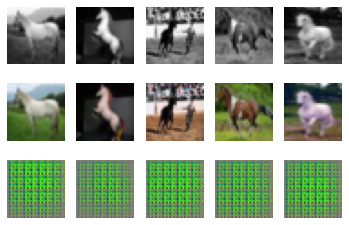

1 tensor(2.9677) tensor(0.9555)


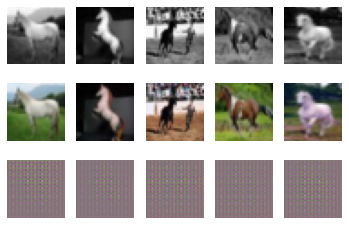

2 tensor(4.2804) tensor(0.0522)


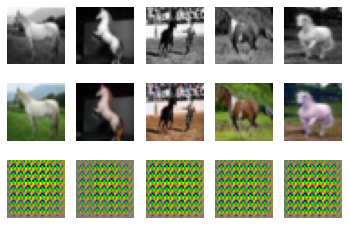

3 tensor(2.7773) tensor(0.4013)


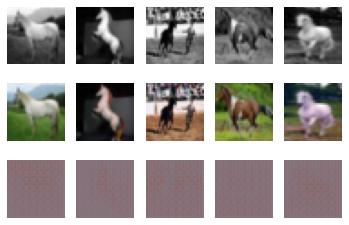

4 tensor(3.5422) tensor(0.2930)


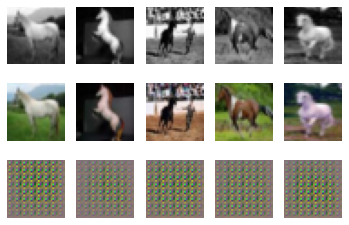

5 tensor(4.7293) tensor(0.0606)


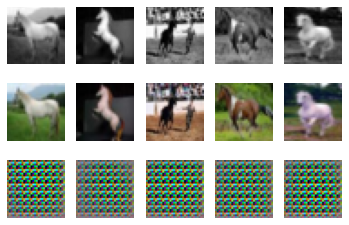

6 tensor(5.1908) tensor(0.0125)


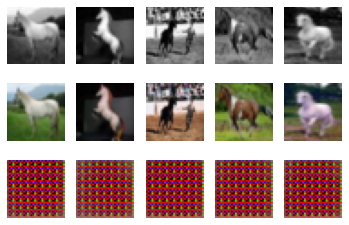

7 tensor(4.7874) tensor(0.0975)


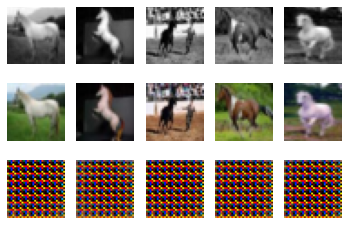

8 tensor(8.8936) tensor(0.0019)


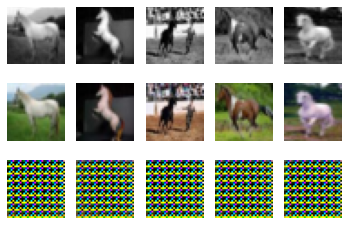

9 tensor(8.4509) tensor(0.0026)


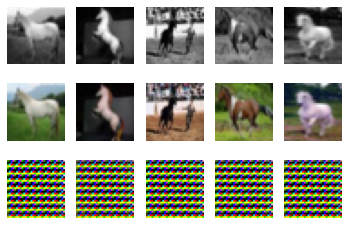

10 tensor(7.9790) tensor(0.0018)


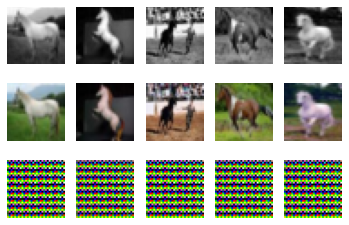

11 tensor(9.5464) tensor(0.0139)


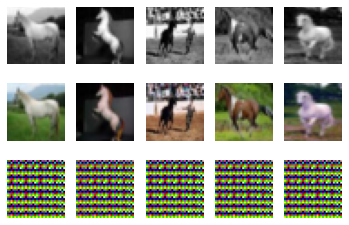

12 tensor(9.1815) tensor(0.0035)


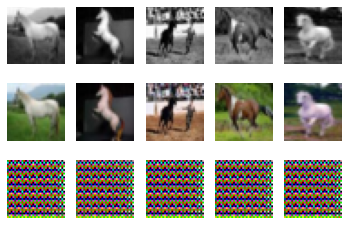

13 tensor(9.0589) tensor(0.0008)


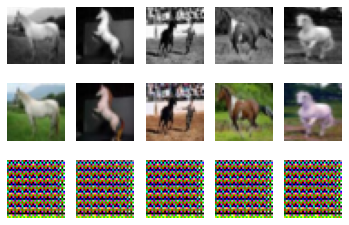

14 tensor(7.4292) tensor(0.0583)


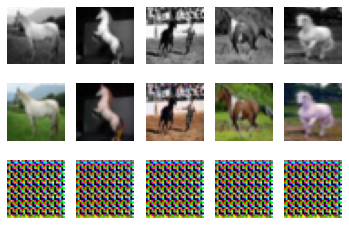

15 tensor(11.5097) tensor(0.0003)


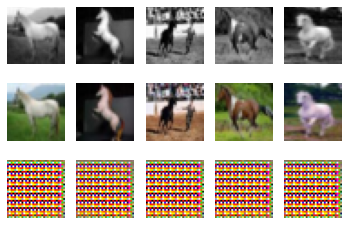

16 tensor(6.2406) tensor(0.0942)


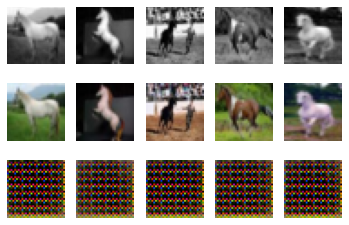

17 tensor(5.8330) tensor(0.6450)


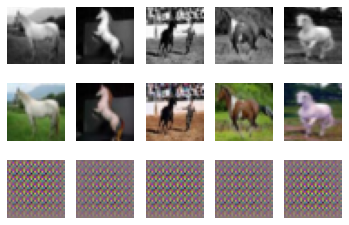

18 tensor(6.5516) tensor(0.1337)


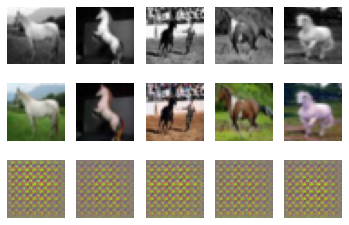

19 tensor(5.0193) tensor(0.0695)


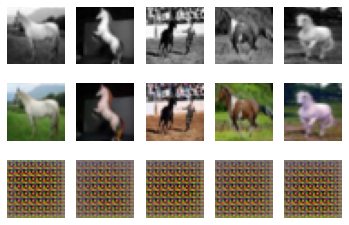

20 tensor(7.7400) tensor(0.0134)


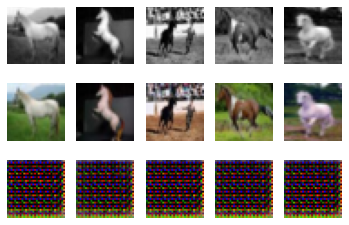

21 tensor(7.0987) tensor(0.0364)


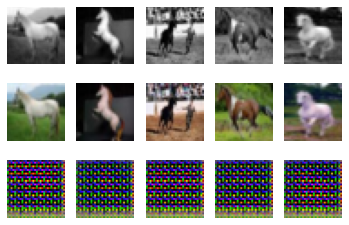

22 tensor(8.1760) tensor(0.1902)


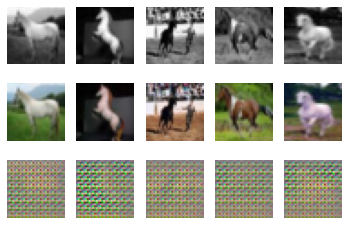

23 tensor(5.1516) tensor(0.1997)


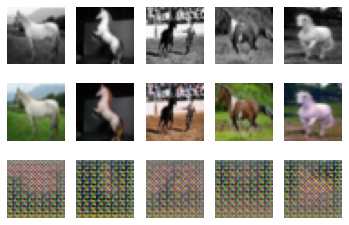

24 tensor(2.8985) tensor(0.6724)


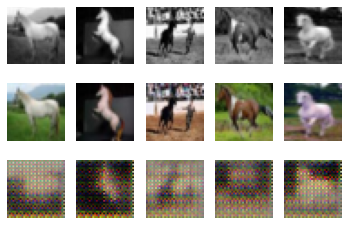

25 tensor(3.1792) tensor(0.7916)


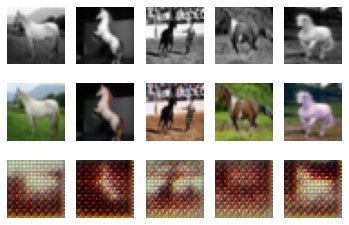

26 tensor(4.2768) tensor(0.3818)


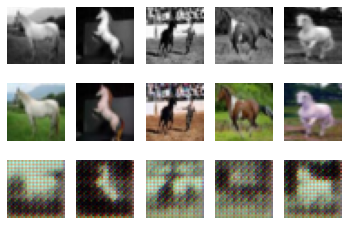

27 tensor(3.2370) tensor(0.2821)


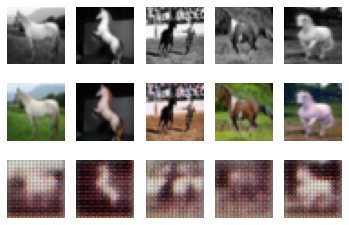

28 tensor(4.0748) tensor(0.4448)


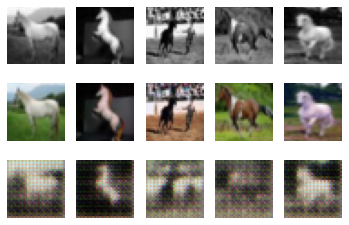

29 tensor(3.2546) tensor(0.5690)


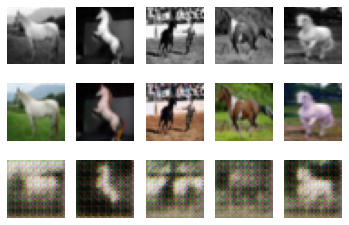

30 tensor(3.4434) tensor(0.2518)


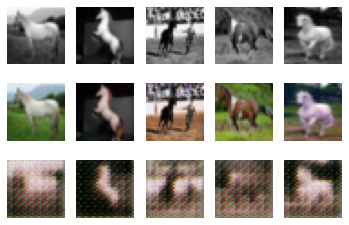

31 tensor(3.9405) tensor(0.3935)


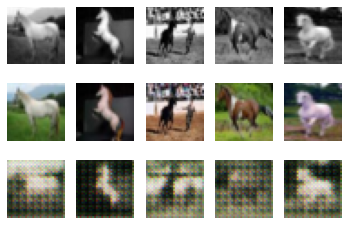

32 tensor(2.6276) tensor(0.2085)


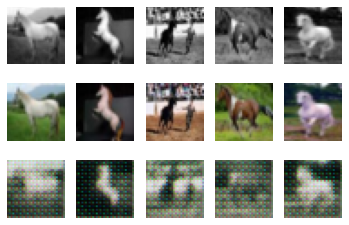

33 tensor(2.2357) tensor(0.5733)


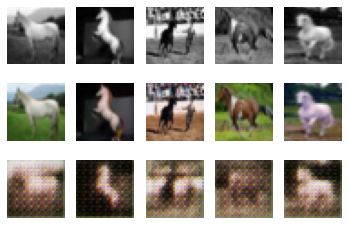

34 tensor(3.7607) tensor(0.3745)


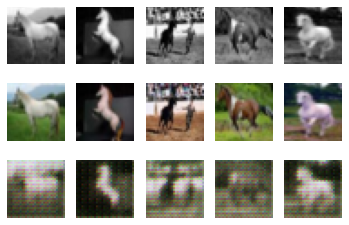

35 tensor(2.5483) tensor(0.4649)


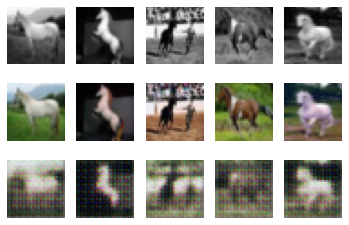

36 tensor(3.5488) tensor(0.4317)


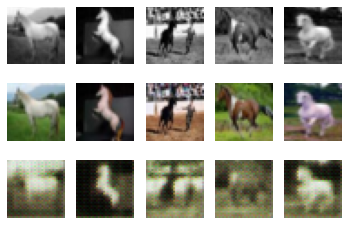

37 tensor(3.0375) tensor(0.7230)


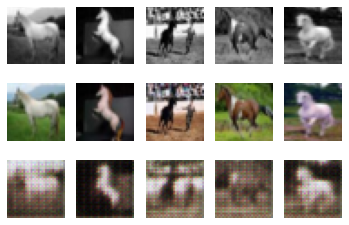

38 tensor(3.3898) tensor(0.1179)


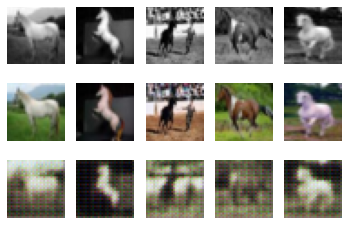

39 tensor(3.6006) tensor(0.6377)


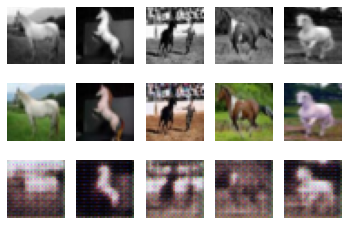

40 tensor(3.2375) tensor(0.3335)


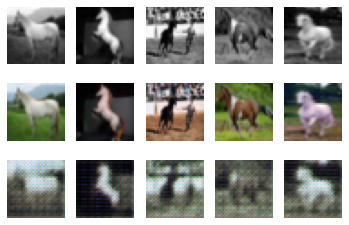

41 tensor(2.7020) tensor(0.5823)


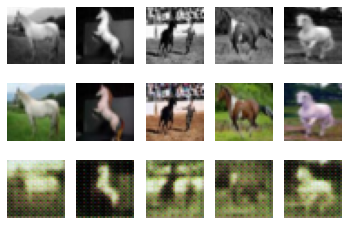

42 tensor(3.7849) tensor(0.3572)


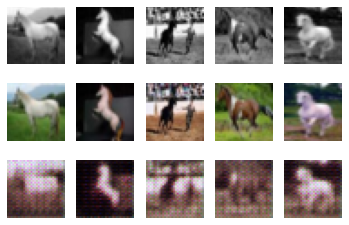

43 tensor(3.5007) tensor(0.3139)


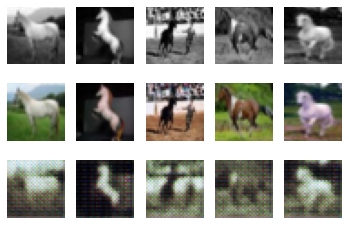

44 tensor(3.2283) tensor(0.3338)


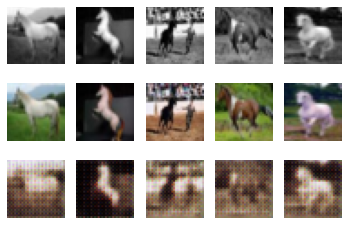

45 tensor(2.9689) tensor(0.2648)


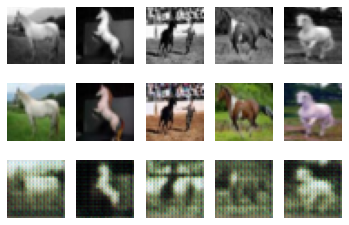

46 tensor(3.1874) tensor(0.4172)


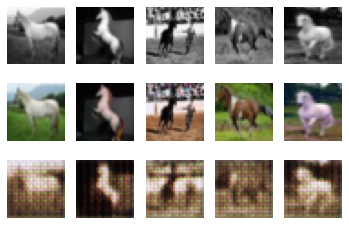

47 tensor(3.3622) tensor(0.7189)


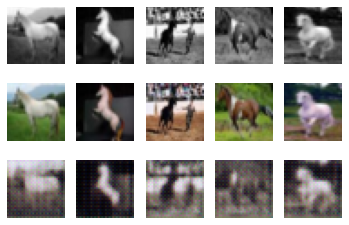

48 tensor(3.4143) tensor(0.2968)


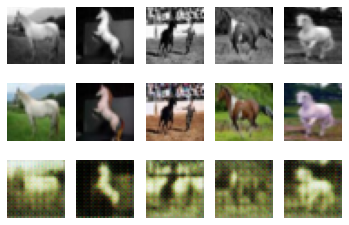

49 tensor(4.1337) tensor(0.4501)


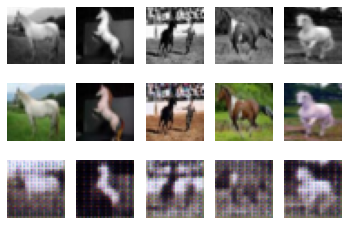

50 tensor(2.2640) tensor(0.5741)


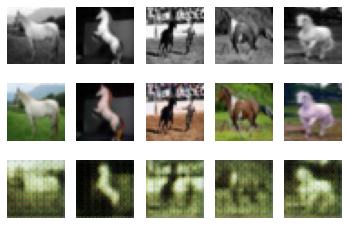

51 tensor(3.4497) tensor(0.3484)


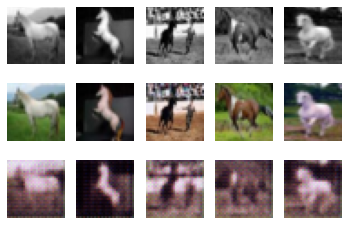

52 tensor(3.7317) tensor(0.3609)


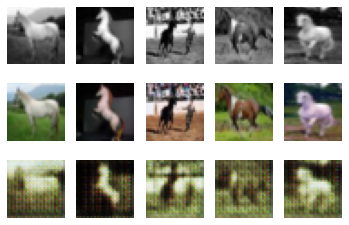

53 tensor(4.5112) tensor(0.1689)


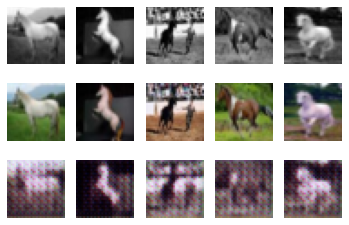

54 tensor(2.7464) tensor(0.5129)


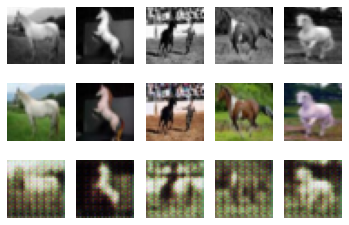

55 tensor(3.8977) tensor(0.3369)


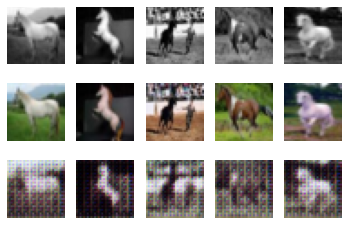

56 tensor(3.7515) tensor(0.2483)


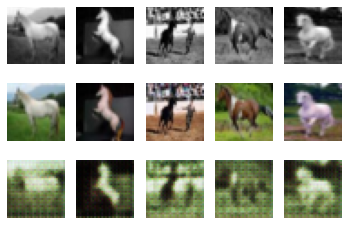

57 tensor(3.0988) tensor(0.3799)


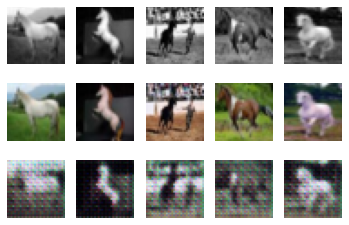

58 tensor(3.4709) tensor(0.1950)


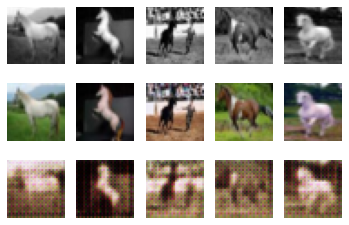

59 tensor(3.7760) tensor(0.0846)


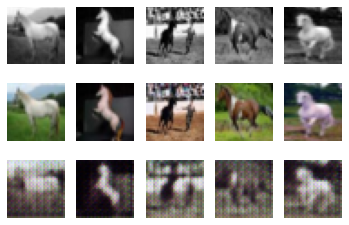

60 tensor(4.6159) tensor(0.0591)


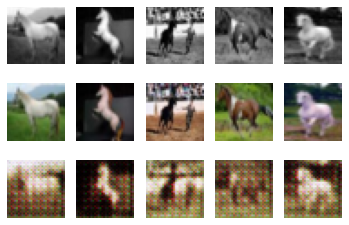

61 tensor(3.6007) tensor(0.4736)


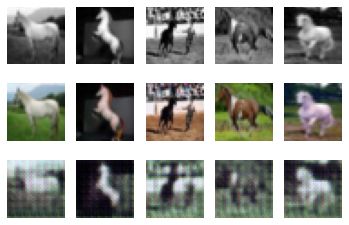

62 tensor(3.0225) tensor(0.2747)


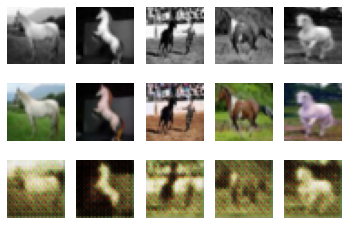

63 tensor(4.0592) tensor(0.5945)


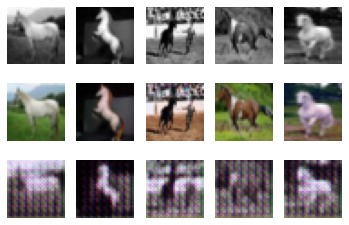

64 tensor(4.0675) tensor(0.1426)


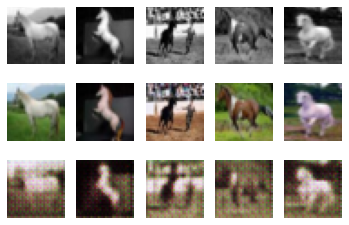

65 tensor(4.6337) tensor(0.4076)


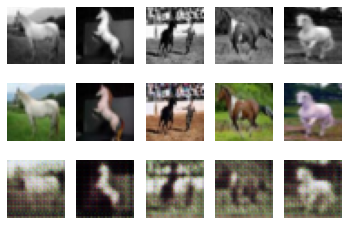

66 tensor(4.0635) tensor(0.1084)


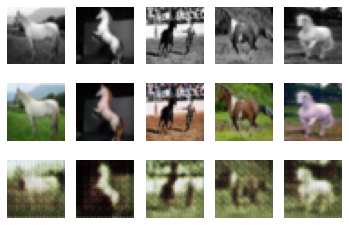

67 tensor(4.1771) tensor(0.3212)


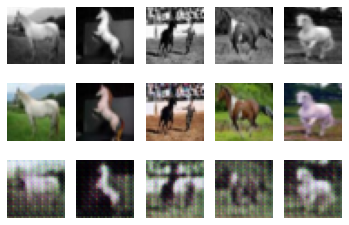

68 tensor(3.2316) tensor(0.2708)


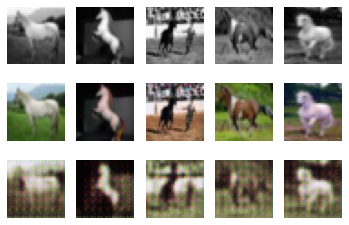

69 tensor(3.9941) tensor(0.8636)


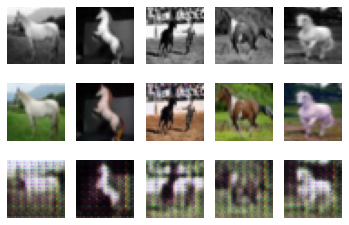

70 tensor(4.1075) tensor(0.7522)


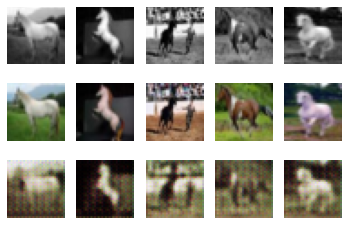

71 tensor(4.1636) tensor(0.2078)


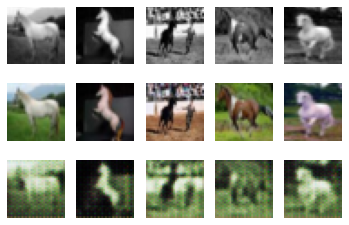

72 tensor(3.2056) tensor(0.3770)


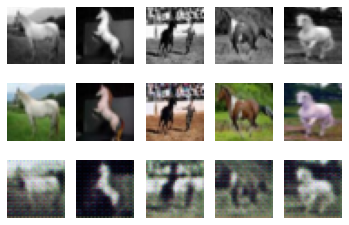

73 tensor(3.6897) tensor(0.2339)


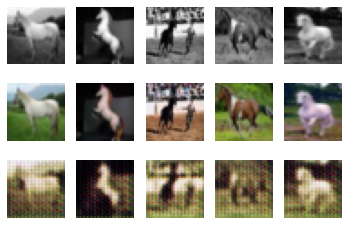

74 tensor(4.1267) tensor(0.6079)


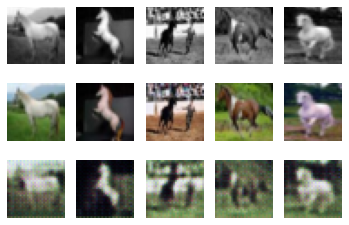

75 tensor(4.8681) tensor(0.2248)


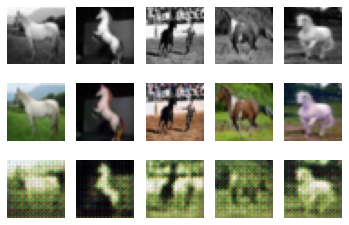

76 tensor(2.9147) tensor(0.2739)


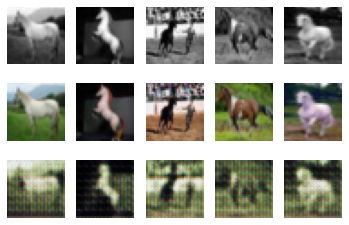

77 tensor(2.7162) tensor(0.5441)


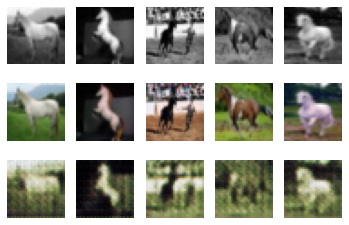

78 tensor(3.0661) tensor(0.7748)


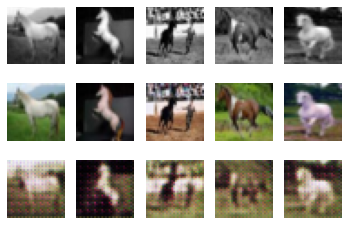

79 tensor(3.7661) tensor(0.3333)


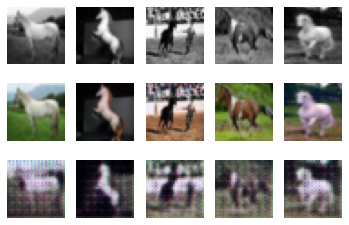

80 tensor(3.1871) tensor(0.1519)


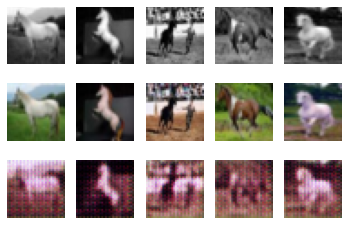

81 tensor(2.6444) tensor(0.3503)


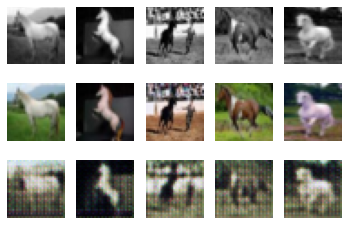

82 tensor(2.8253) tensor(0.6091)


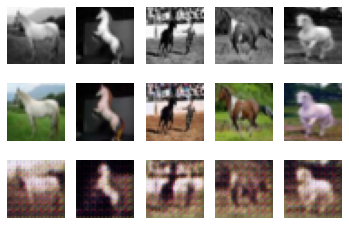

83 tensor(3.1159) tensor(0.1765)


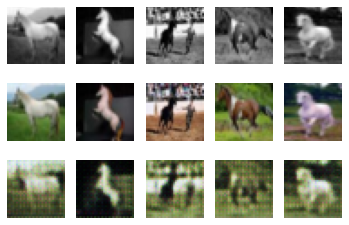

84 tensor(1.9625) tensor(0.3731)


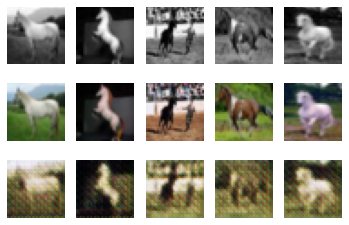

85 tensor(2.5514) tensor(0.4786)


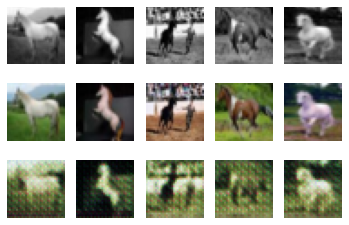

86 tensor(1.7611) tensor(0.7304)


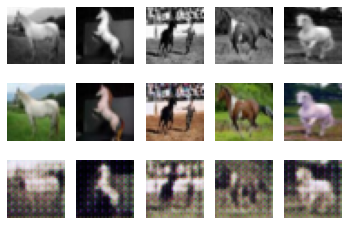

87 tensor(2.4129) tensor(0.3011)


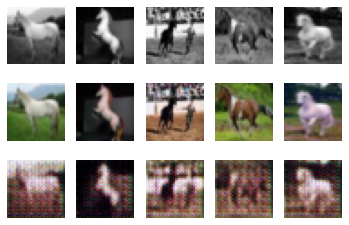

88 tensor(3.0918) tensor(0.7220)


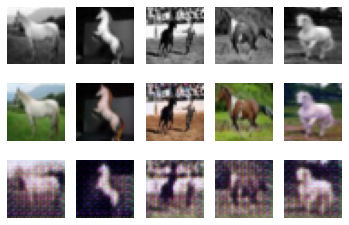

89 tensor(2.7335) tensor(1.3261)


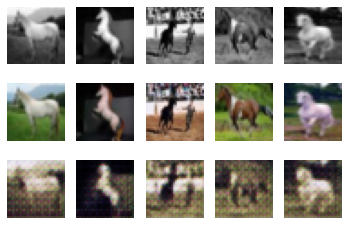

90 tensor(2.1686) tensor(0.3122)


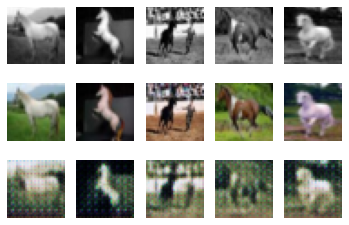

91 tensor(3.7832) tensor(0.6245)


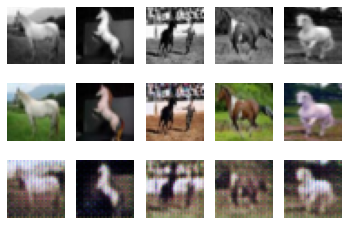

92 tensor(2.2162) tensor(0.5495)


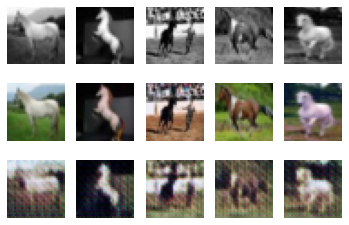

93 tensor(2.3841) tensor(0.4238)


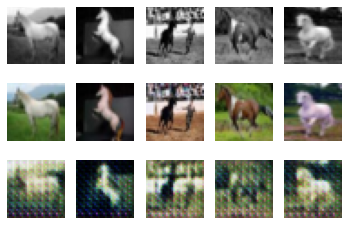

94 tensor(2.7772) tensor(0.4614)


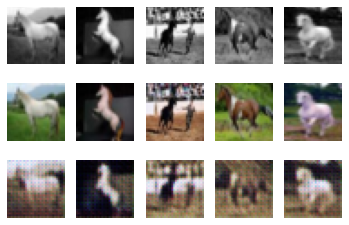

95 tensor(2.5369) tensor(0.8370)


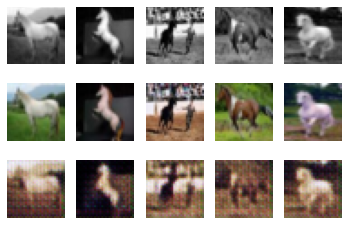

96 tensor(2.1014) tensor(0.6181)


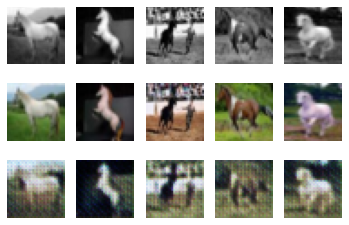

97 tensor(3.6669) tensor(0.4323)


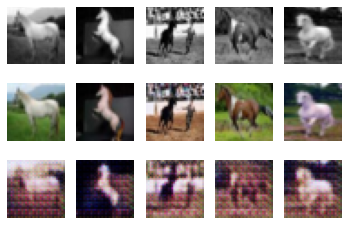

98 tensor(3.0786) tensor(0.2182)


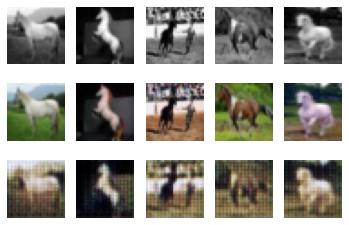

99 tensor(1.9595) tensor(0.7046)


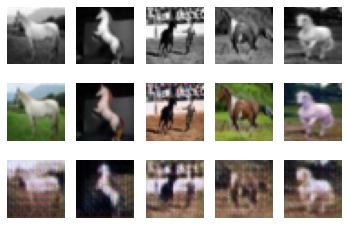

100 tensor(1.4071) tensor(1.4878)


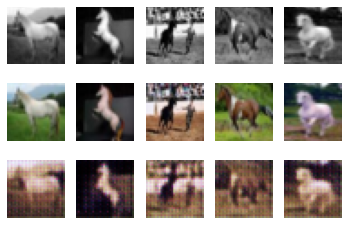

101 tensor(2.4386) tensor(0.2620)


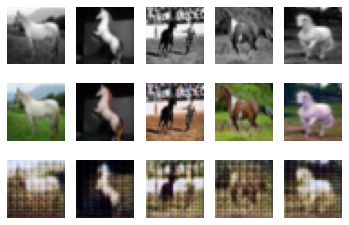

102 tensor(2.8839) tensor(0.1992)


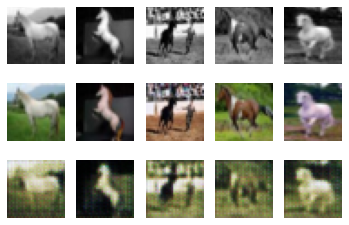

103 tensor(1.6115) tensor(0.9030)


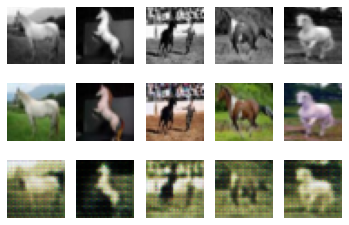

104 tensor(2.8376) tensor(0.6008)


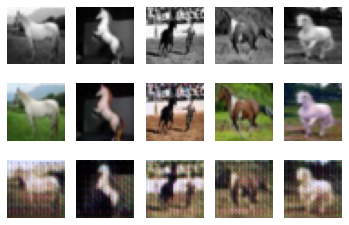

105 tensor(2.4342) tensor(0.5628)


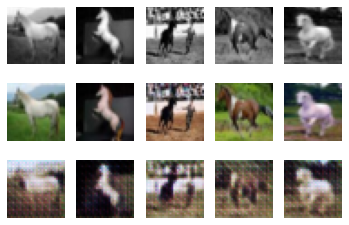

106 tensor(2.9118) tensor(0.6725)


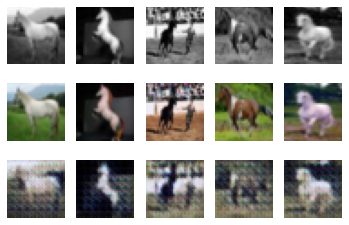

107 tensor(2.1486) tensor(0.4692)


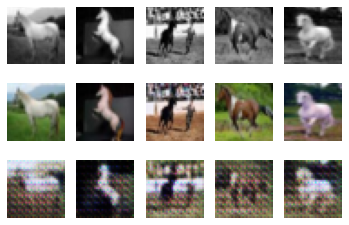

108 tensor(3.3267) tensor(0.5833)


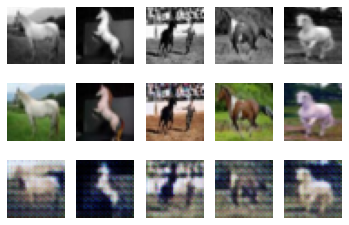

109 tensor(2.5441) tensor(0.2997)


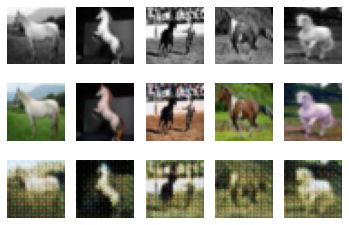

110 tensor(1.9685) tensor(0.6911)


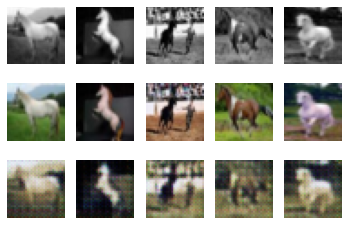

111 tensor(1.6721) tensor(1.0651)


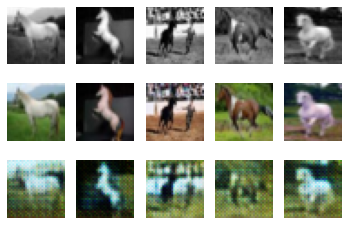

112 tensor(1.3918) tensor(1.1014)


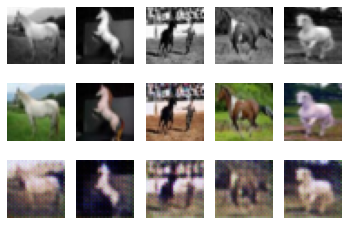

113 tensor(2.6482) tensor(0.3517)


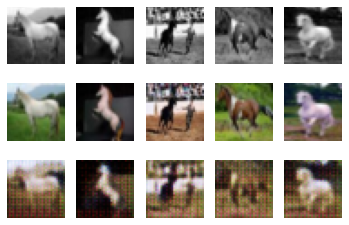

114 tensor(2.3714) tensor(0.4199)


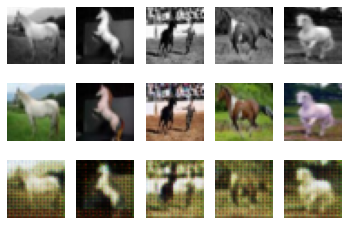

115 tensor(1.7086) tensor(0.9497)


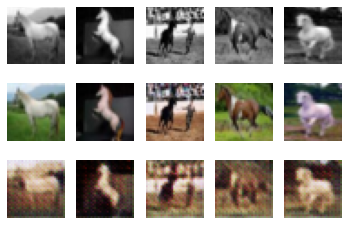

116 tensor(2.5213) tensor(0.3842)


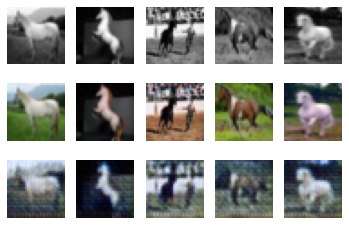

117 tensor(2.2052) tensor(0.4237)


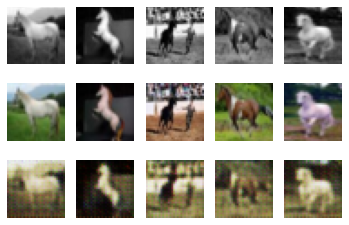

118 tensor(2.1197) tensor(1.0814)


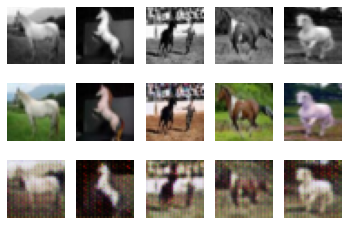

119 tensor(2.4167) tensor(0.6767)


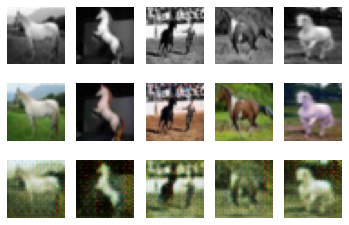

120 tensor(2.0949) tensor(0.4888)


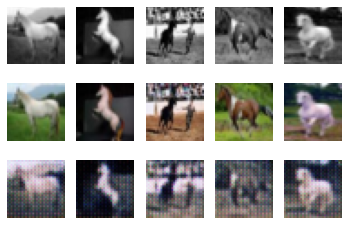

121 tensor(2.6109) tensor(0.1511)


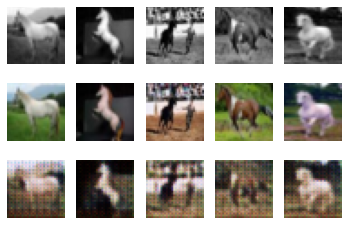

122 tensor(2.3997) tensor(0.8239)


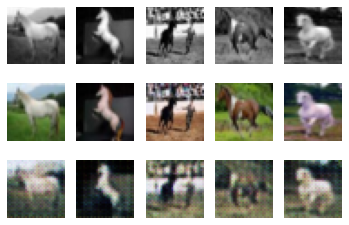

123 tensor(1.6183) tensor(0.9804)


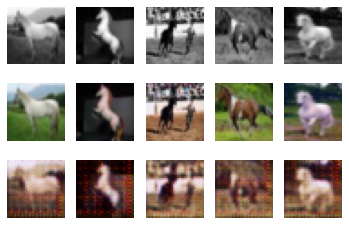

124 tensor(2.5753) tensor(0.4481)


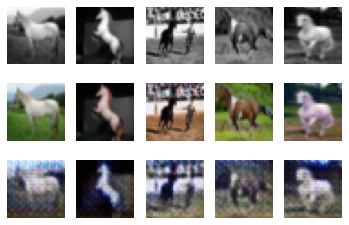

125 tensor(2.6611) tensor(0.5706)


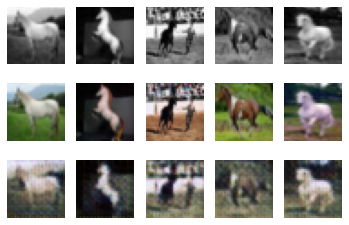

126 tensor(2.8734) tensor(0.2702)


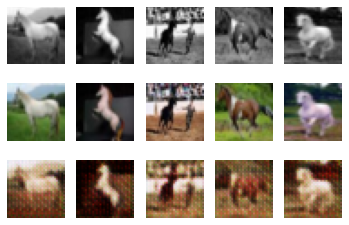

127 tensor(1.6815) tensor(0.4749)


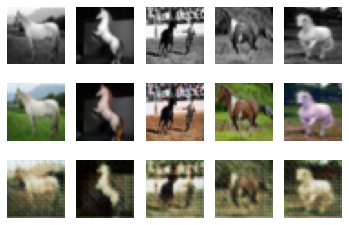

128 tensor(1.9566) tensor(0.7119)


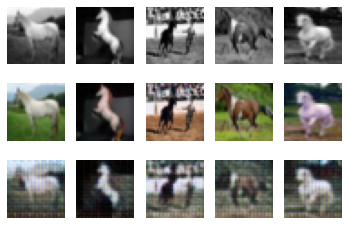

129 tensor(2.4269) tensor(0.7797)


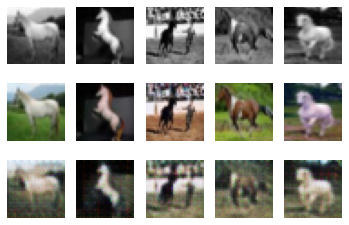

130 tensor(3.1513) tensor(0.1548)


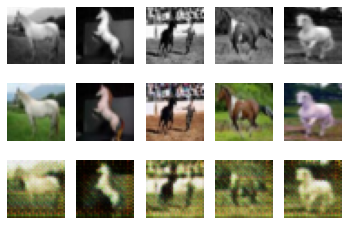

131 tensor(2.2813) tensor(0.6704)


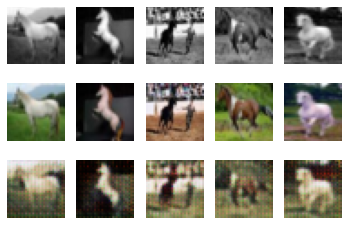

132 tensor(2.3916) tensor(0.7461)


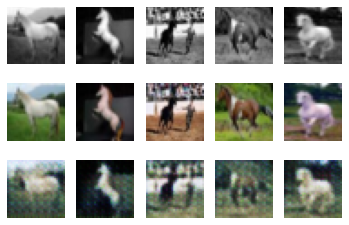

133 tensor(1.9594) tensor(0.6364)


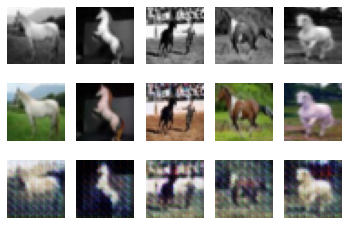

134 tensor(3.1308) tensor(0.5206)


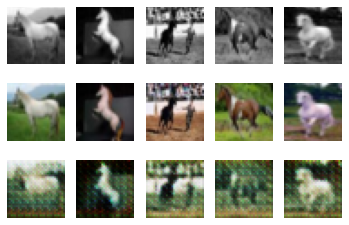

135 tensor(2.2720) tensor(0.5871)


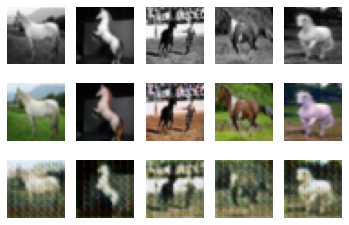

136 tensor(2.9749) tensor(0.3449)


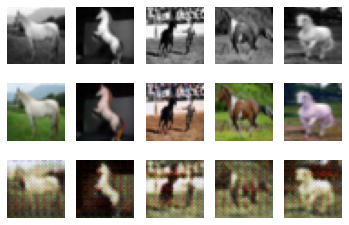

137 tensor(2.3265) tensor(0.5138)


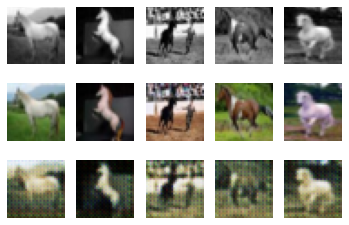

138 tensor(2.8222) tensor(0.1717)


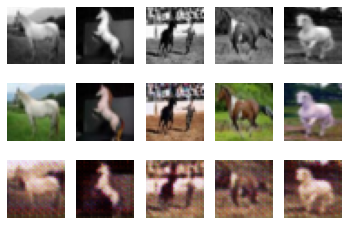

139 tensor(2.7852) tensor(0.7130)


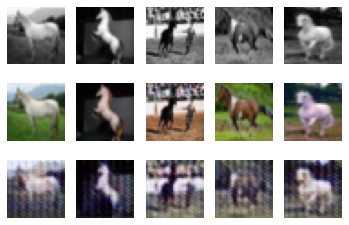

140 tensor(2.5462) tensor(0.4647)


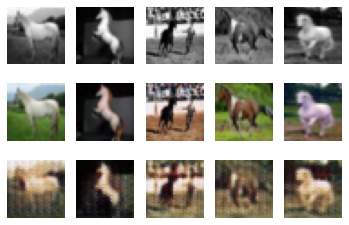

141 tensor(2.5819) tensor(0.1907)


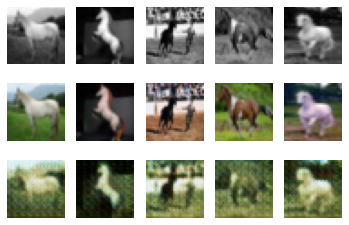

142 tensor(2.6942) tensor(1.4187)


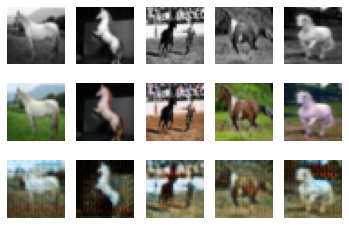

143 tensor(2.1164) tensor(0.3208)


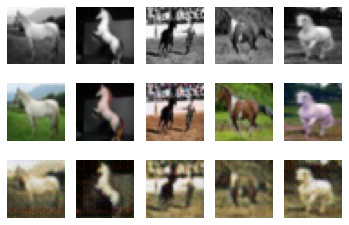

144 tensor(2.5056) tensor(0.4910)


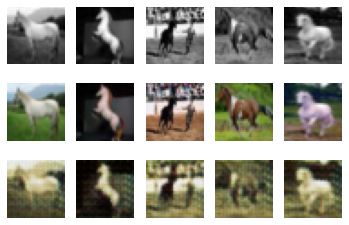

145 tensor(3.4164) tensor(0.2674)


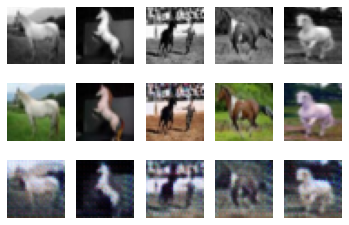

146 tensor(2.8363) tensor(0.1453)


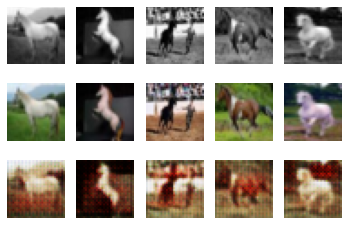

147 tensor(1.4541) tensor(1.2574)


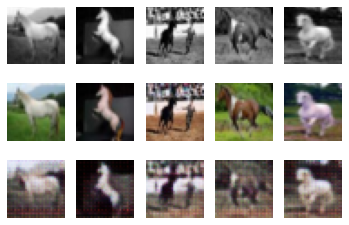

148 tensor(2.6745) tensor(0.2999)


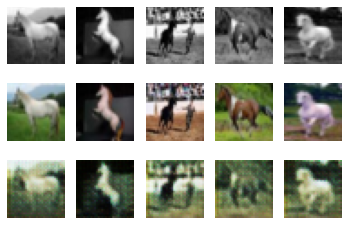

149 tensor(2.7999) tensor(0.3377)


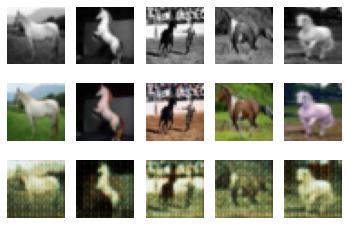

150 tensor(2.4809) tensor(0.2151)


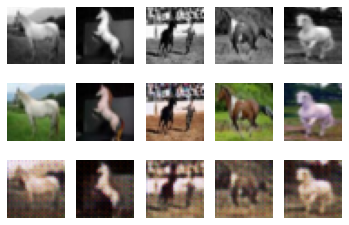

151 tensor(2.5467) tensor(0.4987)


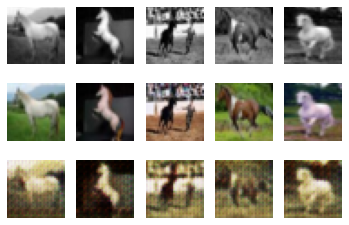

152 tensor(3.2032) tensor(0.7620)


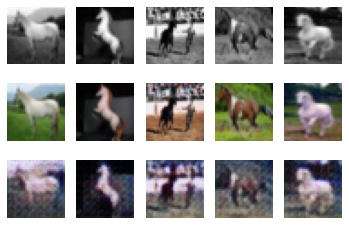

153 tensor(2.6446) tensor(0.6355)


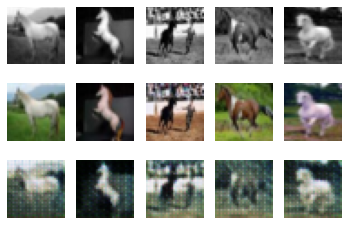

154 tensor(3.1713) tensor(0.5845)


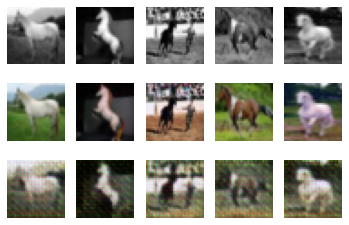

155 tensor(4.2664) tensor(0.3685)


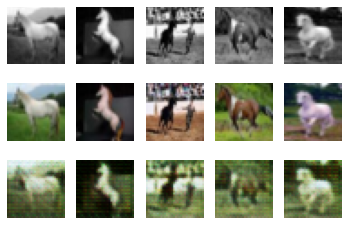

156 tensor(2.5464) tensor(0.5240)


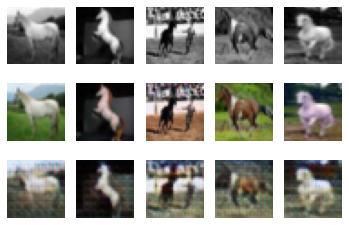

157 tensor(6.6034) tensor(0.0532)


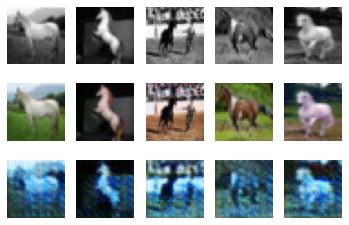

158 tensor(1.6781) tensor(1.1060)


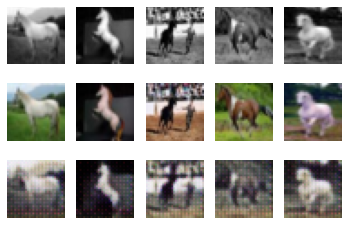

159 tensor(1.9764) tensor(0.7405)


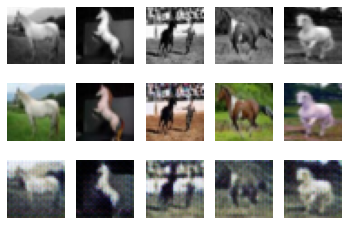

In [ ]:
args = AttrDict()
args_dict = {
    "gpu": True,
    "valid": False,
    "checkpoint": "",
    "colours": "./data/colours/colour_kmeans24_cat7.npy",
    "model": "Generator",
    "kernel": 3,
    "num_filters": 32,
    'learn_rate':0.001, 
    "batch_size": 50,
    "epochs": 160,
    "seed": 1,
    "plot": False,
    "experiment_name": "colourization_cnn",
    "visualize": False,
    "downsize_input": False,
}
args.update(args_dict)
cnn = train(args)

#batch size of 50 with 100 epochs seemed to work



Compared to autoencoders, cGAN takes longer to train, and it takes some time before the model shows any improvement in coloring images. But the final colored images appear to have better quality than the output of autoencoders.

## problems with RGB and possible improvement
RGB images represent sensor data more, which is sensitive to different wavelengths of light. And that is how humans perceive colors. But translated into squared distance, the algorithm would likely to settle for an average distance that minimizes the MSE but doesn't help with improving visual perceptions.

As a non-absolute color space, the distance between colors in RGB color space is not directly related to their perceptual difference, which makes using RGB color space less effective when it comes to images that require visual identifications.

Alternative - using lab colour space representation instead of RBG which simplifies the problem and requires you to predict two output channels instead of three

In [ ]:
from matplotlib import transforms
#lab color space
HORSE_CATEGORY = 7
from skimage.color import rgb2lab, lab2rgb
def process_lab(xs, ys, downsize_input=False):

    xs = xs[np.where(ys == HORSE_CATEGORY)[0], :, :, :]
    npr.shuffle(xs)
    xs = np.transpose(xs, [0, 2,3,1])
    lab = rgb2lab(xs)
    l = lab[:,:,:,0:1] / 50. - 1.
    ab = lab[:,:,:,1:3] / 110.
    l = np.transpose(l,[0,3,1,2])
    ab = np.transpose(ab,[0,3,1,2])
    #rgb = lab2rgb(lab)
    #rgb = np.transpose(rgb,[0,3,1,2])
    #rgb = xs/256.0
    #rgb = np.transpose(rgb, [0,3,1,2])
    return (ab, l)

In [ ]:
(x_train, y_train), (x_test, y_test) = load_cifar10()

File path: data/cifar-10-batches-py.tar.gz


In [ ]:
ab, l= process_lab(x_train, y_train)

In [ ]:
com = np.zeros((5000,3,32,32))
com[:,0:1,:,:]=(l+1.)*50.
com[:,1:3,:,:]=ab*110.
com=lab2rgb(np.transpose(com,[0,2,3,1]))

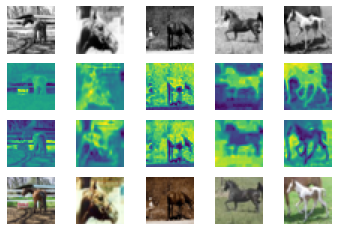

In [ ]:
#visualization
img_grey = np.transpose(l[:5, :, :, :], [0, 2, 3, 1]).squeeze()
img_a = np.transpose(ab[:5, 0:1, :, :], [0, 2, 3, 1]).squeeze()
img_b = np.transpose(ab[:5, 1:2, :, :], [0, 2, 3, 1]).squeeze()
rgb =com[:5, :, :, :]
for i in range(5):
    ax = plt.subplot(4, 5, i + 1)
    ax.imshow(img_grey[i], cmap='gray')
    ax.axis('off')
    ax = plt.subplot(4, 5, i + 1 + 5)
    ax.imshow(img_a[i])
    ax.axis('off')
    ax = plt.subplot(4, 5, i + 1 + 10)
    ax.imshow(img_b[i])
    ax.axis('off')
    ax = plt.subplot(4, 5, i + 1 + 15)
    ax.imshow(rgb[i])
    ax.axis('off')
plt.show()

In [ ]:
#test on unet

class UNet_t(nn.Module):
    def __init__(self, kernel, num_filters, num_colours=2, num_in_channels=1):
        super().__init__()

        # parameters
        stride = 2
        padding = kernel // 2
        output_padding = 1

        self.conv1=nn.Conv2d(1, num_filters, kernel, stride=2, padding=padding)
        self.conv2=nn.Conv2d(num_filters, num_filters*2, kernel, stride=2, padding=padding)
        self.conv3=nn.Conv2d(num_filters*2, num_filters*4, kernel, stride=2, padding=padding)
        self.conv=nn.Conv2d(num_filters*4, num_filters*2,1, stride=1, padding=0)
        self.conv0=nn.Conv2d(num_filters*2, num_filters,1, stride=1, padding=0)
        self.conv4=nn.ConvTranspose2d(num_filters*4, num_filters*2, kernel,stride=2, padding=padding, output_padding = 1)
        self.conv5=nn.ConvTranspose2d(num_filters*2, num_filters, kernel, stride=2, padding=padding, output_padding = 1)
        self.conv6=nn.ConvTranspose2d(num_filters, 2, kernel, stride=2, padding=padding, output_padding = 1)

    def forward(self, x):
        
        out1 = F.relu(self.conv1(x)) #32, 16,16
        out2 = F.relu(self.conv2(out1))
        
        out3 = F.relu(self.conv3(out2)) #bottle-neck 128,4,4
        out4 = F.relu(self.conv4(out3)) #64,8,8

        concat1 = torch.cat((out4,out2), dim=1) # 128,8,8
        out5_skip=F.relu(self.conv(concat1)) #64,8,8
        out5 = F.relu(self.conv5(out5_skip)) #32,16,16
        concat2 = torch.cat((out5,out1), dim=1)
        out6_skip=F.relu(self.conv0(concat2))
        out6 = self.conv6(out6_skip)
        out=F.sigmoid(out6)

        return out

In [ ]:
def get_torch_vars_lab(xs, ys, gpu=False):

    xs = torch.from_numpy(xs).float()
    ys = torch.from_numpy(ys).float()
    #zs = torch.from_numpy(zs).float()
    if gpu:
        xs = xs.cuda()
        ys = ys.cuda()
     #   zs = zs.cuda()
    return Variable(xs), Variable(ys)#, Variable(zs)
def get_batch_lab(x, y, batch_size):

    N = np.shape(x)[0]
    assert N == np.shape(y)[0]
    for i in range(0, N, batch_size):
        batch_x = x[i : i + batch_size, :, :, :]
        batch_y = y[i : i + batch_size, :, :, :]
        yield (batch_x, batch_y)
def visual_lab(img_grey, img_lab, img_fake, args):
  img_grey = img_grey.cpu().detach().numpy()
  img_lab = img_lab.cpu().detach().numpy()
  img_fake = img_fake.cpu().detach().numpy()
  pic_1 = np.zeros((args.batch_size,3,32,32))
  pic_1[:,0:1,:,:]=(img_grey+1.)*50.
  pic_1[:,1:3,:,:]=img_lab*110.
  img_real=lab2rgb(np.transpose(pic_1,[0,2,3,1]))
  pic_2 = np.zeros((args.batch_size,3,32,32))
  pic_2[:,0:1,:,:]=(img_grey+1.)*50.
  pic_2[:,1:3,:,:]=img_fake*110.
  img_fake=lab2rgb(np.transpose(pic_2,[0,2,3,1]))
  #correct image structure
  img_grey = np.transpose(img_grey[:5, :, :, :], [0, 2, 3, 1]).squeeze()
  img_real = img_real[:5, :, :, :]
  img_fake = img_fake[:5, :, :, :]

  for i in range(5):
      ax = plt.subplot(3, 5, i + 1)
      ax.imshow(img_grey[i], cmap='gray')
      ax.axis("off")
      ax = plt.subplot(3, 5, i + 1 + 5)
      ax.imshow(img_real[i])
      ax.axis("off")
      ax = plt.subplot(3, 5, i + 1 + 10)
      ax.imshow(img_fake[i])
      ax.axis("off")
  plt.show()

def train_lab(args, gen=None):

    # Numpy random seed
    npr.seed(args.seed)

    # Save directory
    save_dir = "outputs/" + args.experiment_name

    # LOAD THE MODEL
    if gen is None:
        Net = globals()[args.model]
        gen = Net(args.kernel, args.num_filters)

    # LOSS FUNCTION
    criterion = nn.MSELoss()
    optimizer = torch.optim.Adam(gen.parameters(), lr=args.learn_rate)

    # DATA
    print("Loading data...")
    (x_train, y_train), (x_test, y_test) = load_cifar10()

    print("Transforming data...")
    train_ab, train_grey = process_lab(x_train, y_train, downsize_input=args.downsize_input)
    test_ab, test_grey = process_lab(x_test, y_test, downsize_input=args.downsize_input)

    # Create the outputs folder if not created already
    if not os.path.exists(save_dir):
        os.makedirs(save_dir)

    print("Beginning training ...")
    if args.gpu:
        gen.cuda()
    start = time.time()

    train_losses = []
    valid_losses = []
    valid_accs = []
    for epoch in range(args.epochs):
        # Train the Model
        gen.train()  # Change model to 'train' mode
        losses = []
        for i, (xs, ys) in enumerate(get_batch_lab(train_grey, train_ab, args.batch_size)):
            images, lab= get_torch_vars_lab(xs, ys, args.gpu)

            optimizer.zero_grad()
            outputs = gen(images)

            loss = criterion(outputs, lab)
            loss.backward()
            optimizer.step()
            losses.append(loss.data.item())

        train_losses.append(np.sum(losses)/(i+1))

        print(epoch, loss.cpu().detach())
        if args.plot:
          visual_lab(images, lab, outputs,args)
    
    return gen

In [ ]:
args = AttrDict()
args_dict = {
    "gpu": True,
    "valid": False,
    "checkpoint": "",
    "colours": "./data/colours/colour_kmeans24_cat7.npy",
    "model": "UNet_t",
    "kernel": 3,
    "num_filters": 32,
    'learn_rate':0.001, 
    "batch_size": 100,
    "epochs": 80,
    "seed": 1,
    "plot": True,
    "experiment_name": "colourization_lab",
    "visualize": False,
    "downsize_input": False,
}
args.update(args_dict)
cnn= train_lab(args)
#Note: outputs are omitted due to file size restrictions

In [ ]:
class Generator_lab(nn.Module):
    def __init__(self, kernel, num_filters, num_colours=2, num_in_channels=1):
        super().__init__()
        #self.label_emb = nn.Embedding(1, 10)
        #parameters
        stride = 2
        padding = kernel // 2
        output_padding = 1

       
        self.conv1=nn.Conv2d(1, num_filters, kernel, stride=2, padding=padding)
        self.conv2=nn.Conv2d(num_filters, num_filters*2, kernel, stride=2, padding=padding)
        self.conv3=nn.Conv2d(num_filters*2, num_filters*4, kernel, stride=2, padding=padding)
        self.conv=nn.Conv2d(num_filters*4, num_filters*2,1, stride=1, padding=0)
        self.conv0=nn.Conv2d(num_filters*2, num_filters,1, stride=1, padding=0)
        self.conv4=nn.ConvTranspose2d(num_filters*4, num_filters*2, kernel,stride=2, padding=padding, output_padding = 1)
        self.conv5=nn.ConvTranspose2d(num_filters*2, num_filters, kernel, stride=2, padding=padding, output_padding = 1)
        self.conv6=nn.ConvTranspose2d(num_filters, 2, kernel, stride=2, padding=padding, output_padding = 1)
        self.tanh=nn.Tanh()
        

    def forward(self, x):
   
        out1 = F.relu(self.conv1(x)) #32, 16,16
        out2 = F.relu(self.conv2(out1))
        
        out3 = F.relu(self.conv3(out2)) #bottle-neck 128,4,4
        out4 = F.relu(self.conv4(out3)) #64,8,8

        concat1 = torch.cat((out4,out2), dim=1) # 128,8,8
        out5_skip=F.relu(self.conv(concat1)) #64,8,8
        out5 = F.relu(self.conv5(out5_skip)) #32,16,16
        concat2 = torch.cat((out5,out1), dim=1)
        out6_skip=F.relu(self.conv0(concat2))
        out6 = self.conv6(out6_skip)
  
        out=self.tanh(out6)   #(-1, 1) tanh      

        return out

In [ ]:
class Discriminator_lab(nn.Module):
    def __init__(self, kernel, num_filters, num_colours=2, num_in_channels=3):
        super().__init__()
        
        # parameters
        #stride = 2
        padding = kernel // 2
        #output_padding = 1

      
        self.cov1 = nn.Conv2d(3, num_filters, kernel, stride=2, padding=padding) #34x34x3 - 16x16x32 
        self.cov2 = nn.Conv2d(num_filters, num_filters*2, kernel, stride=2, padding=padding) #8x8x64
        self.cov3 = nn.Conv2d(num_filters*2, num_filters*4, kernel, stride=2, padding=padding)
        #self.cov4 = nn.Conv2d(num_filters*4, num_filters*8, kernel, stride=2, padding=padding) 
        self.fc1 = nn.Linear(4*4*num_filters*4, 512)
        #self.fc2 = nn.Linear(1024, 512)
        self.fc3 = nn.Linear(512, 256)
        self.fc4 = nn.Linear(256, 1)
        self.lr=nn.LeakyReLU(0.2, inplace=True)
        self.do=nn.Dropout(0.3)
        self.sig=nn.Sigmoid()

    def forward(self, x, img_greyscale):
        
        
        out = torch.cat((x, img_greyscale),1) 
        out = self.do(self.lr(self.cov1(out)))
        out = self.do(self.lr(self.cov2(out)))
        out = self.do(self.lr(self.cov3(out)))
        #out = self.do(self.lr(self.cov4(out)))
        #print(out.shape)
        out = out.reshape(-1, 2048) 
        #print(out.shape)
        out = self.do(self.lr(self.fc1(out)))
        #out = self.do(self.lr(self.fc2(out)))
        out = self.do(self.lr(self.fc3(out)))
        out = self.sig(self.fc4(out))

        return out.squeeze()

In [ ]:
def get_model_name(name, epoch):
    path = "model_{0}_epoch{1}".format(name,
                                       epoch)
    return path
def train_gan_lab(args, cnn=None):
    # Set the maximum number of threads to prevent crash in Teaching Labs

    torch.set_num_threads(5)
    npr.seed(args.seed)

    save_dir = "outputs/" + args.experiment_name

    # LOAD THE COLOURS CATEGORIES

    # INPUT CHANNEL
    num_in_channels = 1 if not args.downsize_input else 3
    # LOAD THE MODEL
    if cnn is None:
        Net = globals()[args.model]
        cnn = Net(args.kernel, args.num_filters)
        discriminator = Discriminator_lab(args.kernel, args.num_filters)

    # LOSS FUNCTION

    criterion = nn.BCELoss()
    d_optimizer = torch.optim.Adam(discriminator.parameters(), lr=1e-5)
    g_optimizer = torch.optim.Adam(cnn.parameters(), lr=1e-4)

    # DATA
    print("Loading data...")
    (x_train, y_train), (x_test, y_test) = load_cifar10()

    print("Transforming data...")
    train_ab, train_grey = process_lab(x_train, y_train, downsize_input=args.downsize_input)
    test_ab, test_grey = process_lab(x_test, y_test, downsize_input=args.downsize_input)

    # Create the outputs folder if not created already
    if not os.path.exists(save_dir):
        os.makedirs(save_dir)

    print("Beginning training ...")
    if args.gpu:
        cnn.cuda()
        discriminator.cuda()
    start = time.time()

    train_losses = []
    valid_losses = []
    valid_accs = []
    for epoch in range(args.epochs):
        # Train the Model
        cnn.train()
        discriminator.train()
        losses = []
 
        for i, (xs, ys) in enumerate(get_batch(train_grey, train_ab, args.batch_size)):
            images, lab = get_torch_vars(xs, ys, args.gpu)

            #--->ADDED 5
            img_grey = images
            img_real = lab
            batch_size = args.batch_size
            
            #discriminator training
            d_optimizer.zero_grad()         
            fake_images = cnn(img_grey)
           # print(fake_images.shape)
            fake_validity = discriminator(fake_images, img_grey)
            #print(fake_validity.shape)
            fake_loss = criterion(fake_validity, Variable(torch.zeros(args.batch_size)).cuda())
            real_validity = discriminator(img_real, img_grey)
            real_loss = criterion(real_validity, Variable(torch.ones(args.batch_size)).cuda())   
            d_loss = real_loss + fake_loss
            d_loss.backward()
            d_optimizer.step()

            # generator training
            g_optimizer.zero_grad()
            fake_images = cnn(img_grey)
            validity = discriminator(fake_images, img_grey)
            g_loss = criterion(validity, Variable(torch.ones(args.batch_size)).cuda())
            g_loss.backward()
            g_optimizer.step()

        model_path_g = get_model_name(args.model, epoch)
        model_path_d = get_model_name('discriminator_lab', epoch)
        torch.save(cnn.state_dict(), model_path_g)
        torch.save(discriminator.state_dict(), model_path_d)
        # print and visualize
        print(epoch, g_loss.cpu().detach(), d_loss.cpu().detach())
        visual_lab(images, lab, fake_images, args)

    return cnn

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


Loading data...
File path: data/cifar-10-batches-py.tar.gz
Transforming data...
Beginning training ...
0 tensor(0.6889) tensor(1.3786)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 3532 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


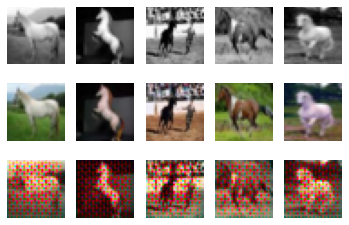

1 tensor(0.6894) tensor(1.3890)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 19 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


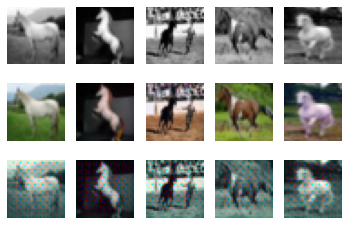

2 tensor(0.6814) tensor(1.3870)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 1225 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


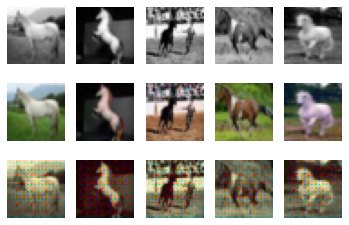

3 tensor(0.6859) tensor(1.3857)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 719 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


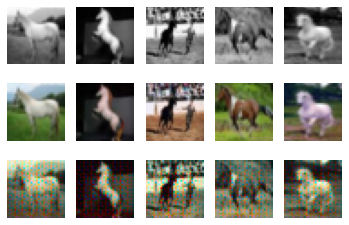

4 tensor(0.6851) tensor(1.3881)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 56 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


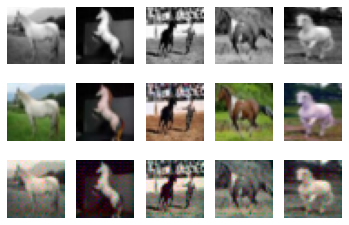

5 tensor(0.6870) tensor(1.3873)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 225 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


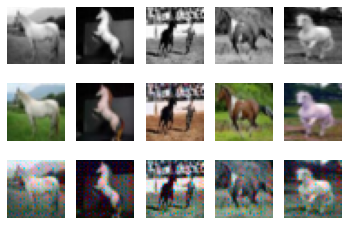

6 tensor(0.6861) tensor(1.3875)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 333 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


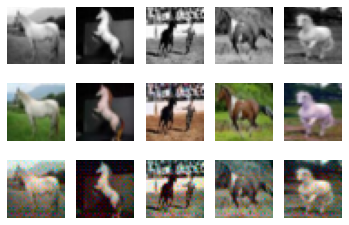

7 tensor(0.6871) tensor(1.3868)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 439 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


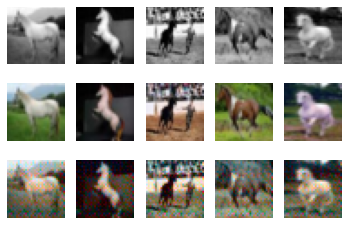

8 tensor(0.6874) tensor(1.3876)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 364 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


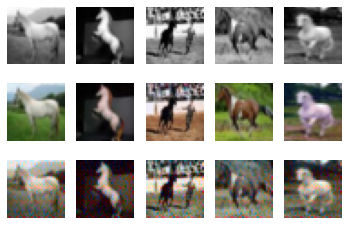

9 tensor(0.6865) tensor(1.3865)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 583 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


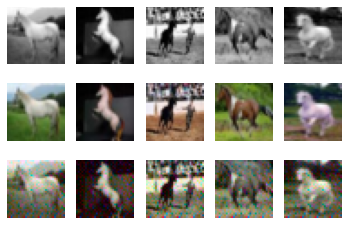

10 tensor(0.6884) tensor(1.3860)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 554 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


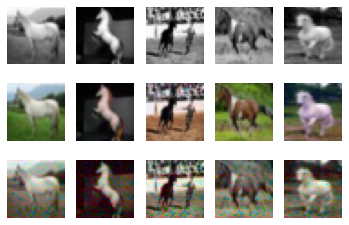

11 tensor(0.6905) tensor(1.3862)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 527 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


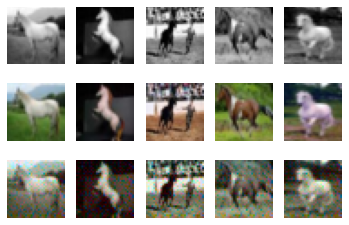

12 tensor(0.6893) tensor(1.3877)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 259 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


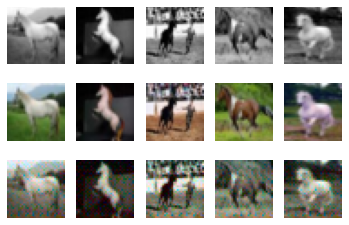

13 tensor(0.6914) tensor(1.3856)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 429 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


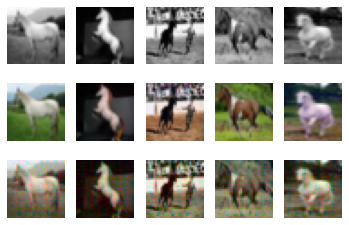

14 tensor(0.6899) tensor(1.3863)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 605 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


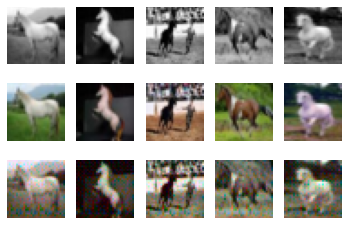

15 tensor(0.6898) tensor(1.3854)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 637 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


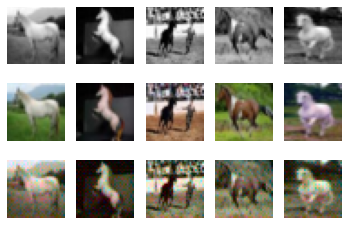

16 tensor(0.6920) tensor(1.3856)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 501 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


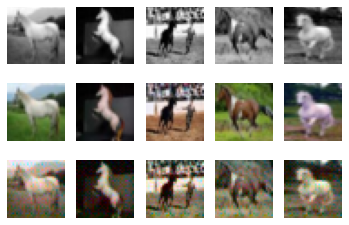

17 tensor(0.6909) tensor(1.3865)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 227 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


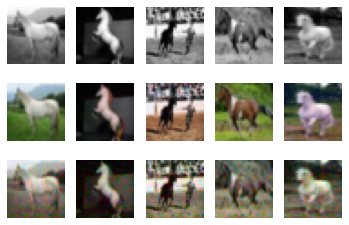

18 tensor(0.6915) tensor(1.3875)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 356 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


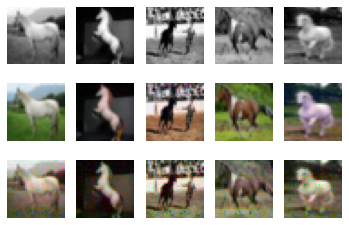

19 tensor(0.6909) tensor(1.3861)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 235 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


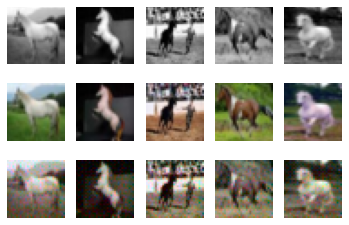

20 tensor(0.6916) tensor(1.3855)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 207 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


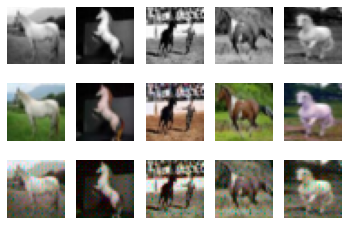

21 tensor(0.6922) tensor(1.3867)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 203 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


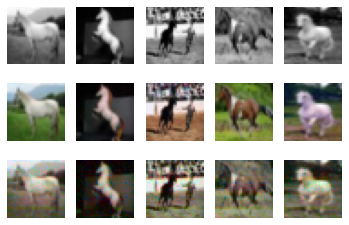

22 tensor(0.6922) tensor(1.3865)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 109 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


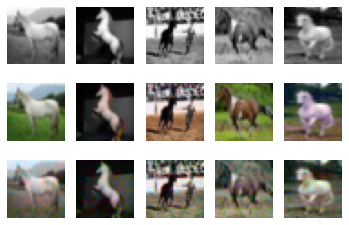

23 tensor(0.6919) tensor(1.3863)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 188 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


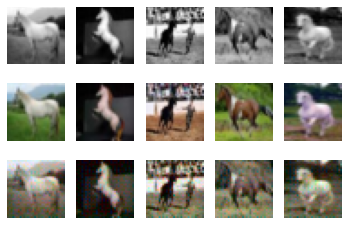

24 tensor(0.6921) tensor(1.3882)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 74 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


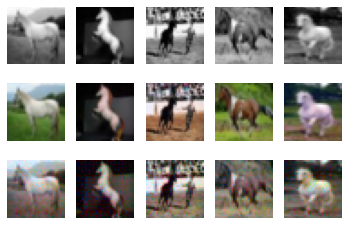

25 tensor(0.6936) tensor(1.3880)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 115 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


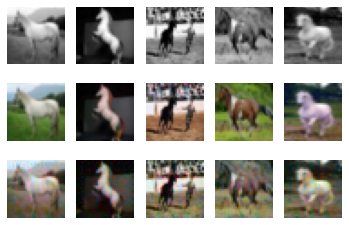

26 tensor(0.6917) tensor(1.3887)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 71 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


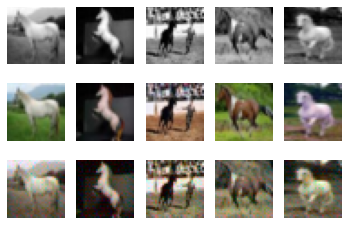

27 tensor(0.6911) tensor(1.3873)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 64 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


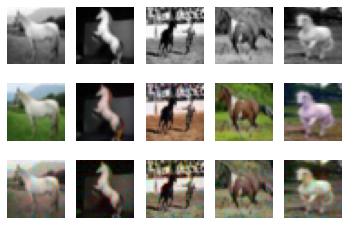

28 tensor(0.6918) tensor(1.3861)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 104 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


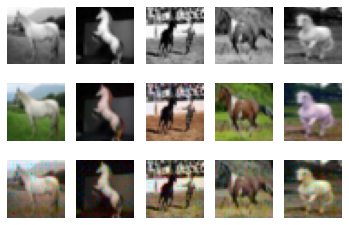

29 tensor(0.6930) tensor(1.3877)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 48 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


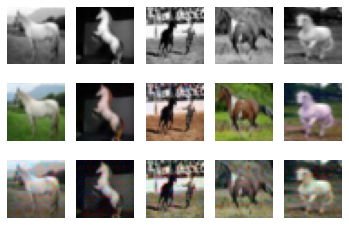

30 tensor(0.6917) tensor(1.3861)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 57 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


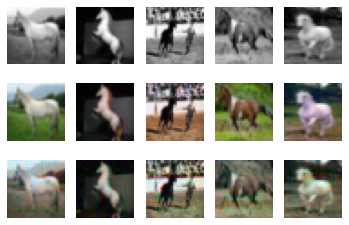

31 tensor(0.6912) tensor(1.3870)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 20 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


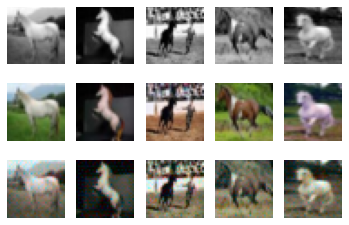

32 tensor(0.6920) tensor(1.3869)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 33 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


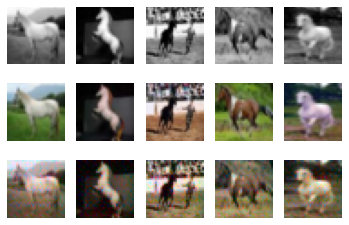

33 tensor(0.6918) tensor(1.3870)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 21 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


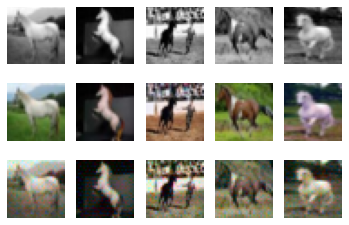

34 tensor(0.6917) tensor(1.3872)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 31 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


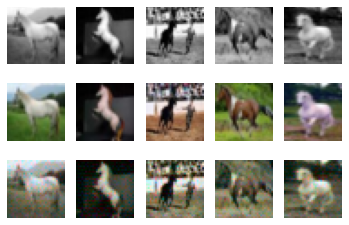

35 tensor(0.6927) tensor(1.3862)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 240 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


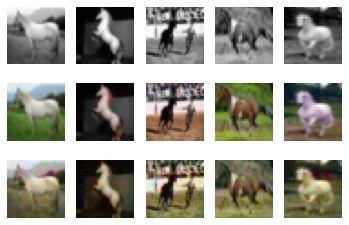

36 tensor(0.6927) tensor(1.3862)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 47 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


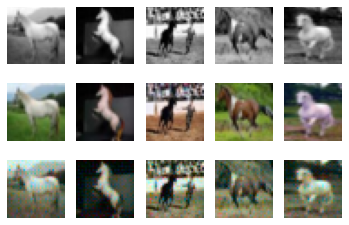

37 tensor(0.6920) tensor(1.3849)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 4 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


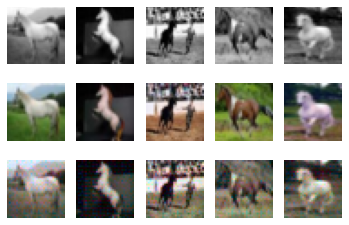

38 tensor(0.6916) tensor(1.3863)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 27 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


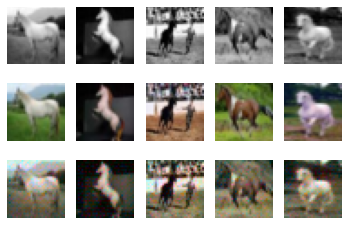

39 tensor(0.6930) tensor(1.3862)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 5 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


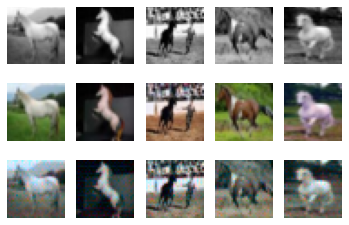

40 tensor(0.6925) tensor(1.3857)


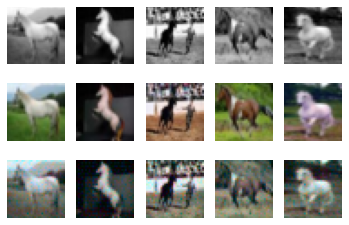

41 tensor(0.6927) tensor(1.3875)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 485 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


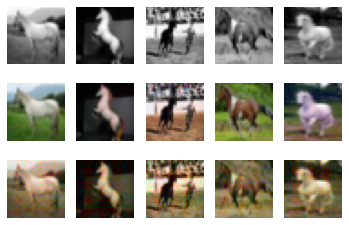

42 tensor(0.6915) tensor(1.3883)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 55 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


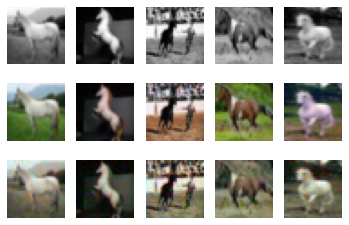

43 tensor(0.6940) tensor(1.3871)


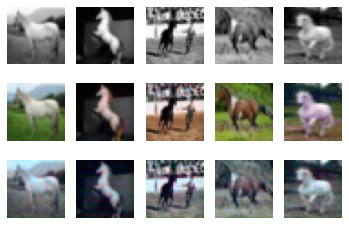

44 tensor(0.6919) tensor(1.3873)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 1116 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


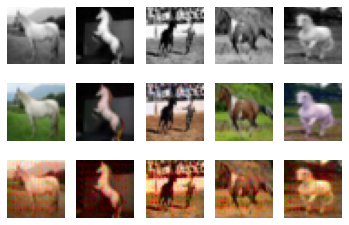

45 tensor(0.6932) tensor(1.3855)


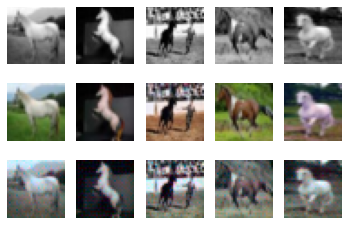

46 tensor(0.6938) tensor(1.3869)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 65 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


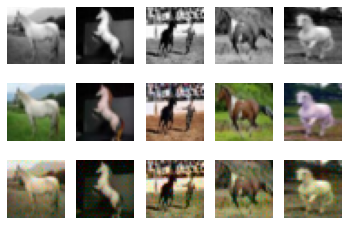

47 tensor(0.6920) tensor(1.3864)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 25 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


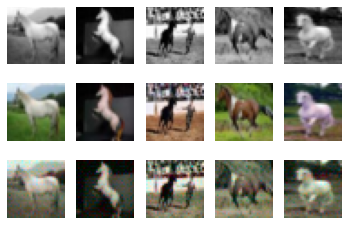

48 tensor(0.6923) tensor(1.3874)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 26 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


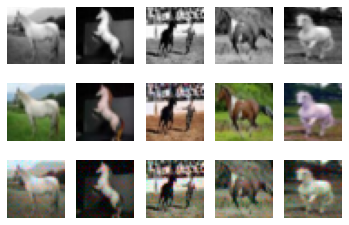

49 tensor(0.6925) tensor(1.3863)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 59 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


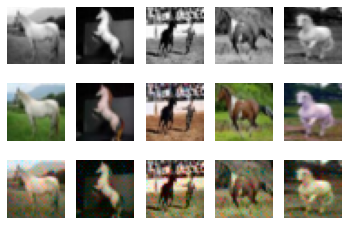

50 tensor(0.6931) tensor(1.3867)


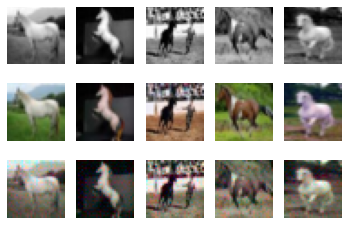

51 tensor(0.6924) tensor(1.3870)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 67 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


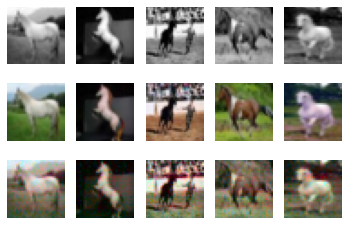

52 tensor(0.6929) tensor(1.3854)


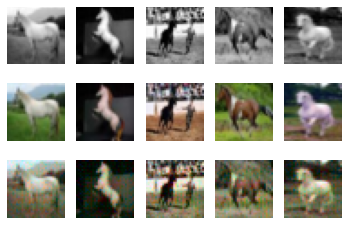

53 tensor(0.6919) tensor(1.3870)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 6 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


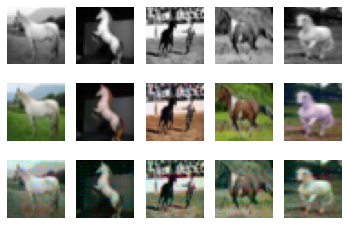

54 tensor(0.6925) tensor(1.3865)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 15 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


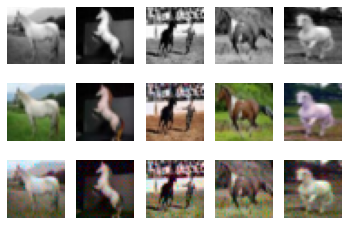

55 tensor(0.6922) tensor(1.3875)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 7 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


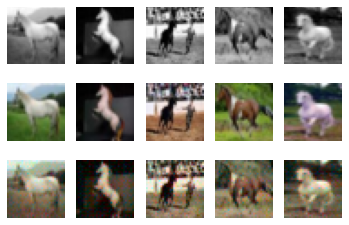

56 tensor(0.6935) tensor(1.3844)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 3 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


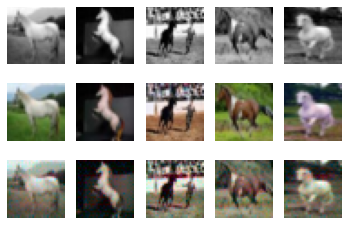

57 tensor(0.6925) tensor(1.3870)


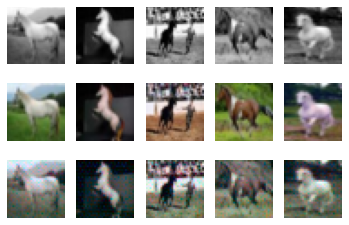

58 tensor(0.6933) tensor(1.3863)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 61 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


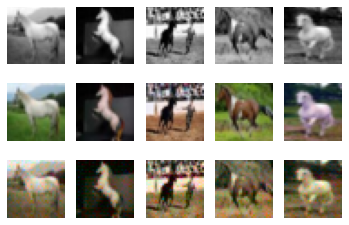

59 tensor(0.6936) tensor(1.3865)


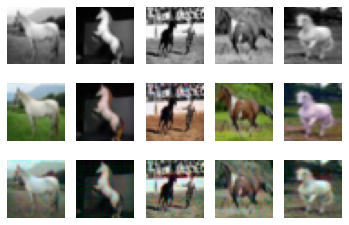

60 tensor(0.6942) tensor(1.3847)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 209 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


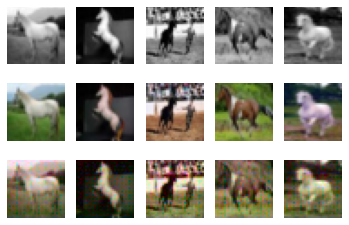

61 tensor(0.6924) tensor(1.3867)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 18 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


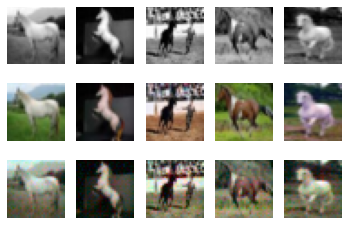

62 tensor(0.6940) tensor(1.3865)


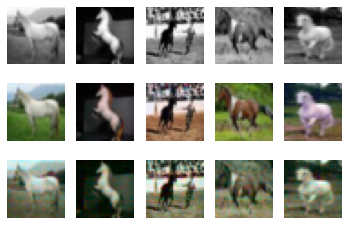

63 tensor(0.6913) tensor(1.3859)


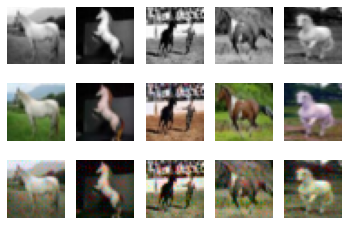

64 tensor(0.6926) tensor(1.3867)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 2 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


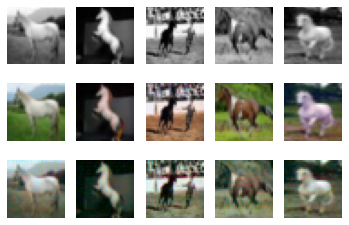

65 tensor(0.6933) tensor(1.3857)


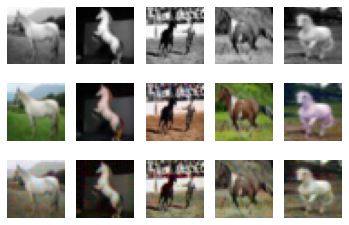

66 tensor(0.6942) tensor(1.3871)


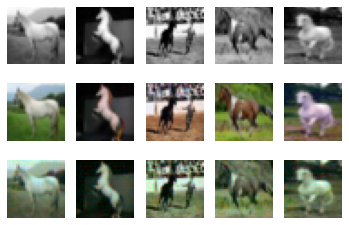

67 tensor(0.6929) tensor(1.3866)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 1 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


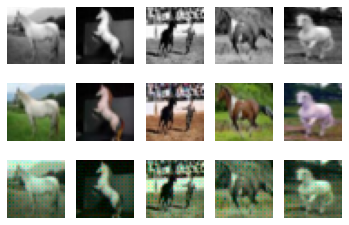

68 tensor(0.6926) tensor(1.3849)


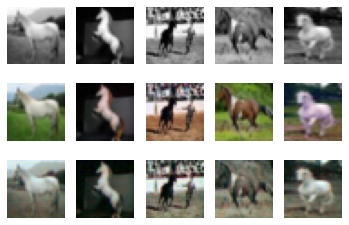

69 tensor(0.6926) tensor(1.3872)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 9 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


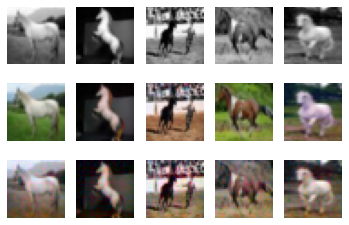

70 tensor(0.6939) tensor(1.3874)


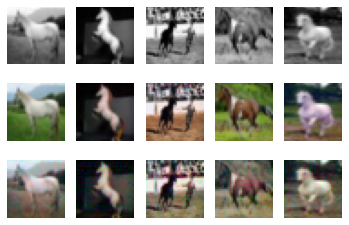

71 tensor(0.6925) tensor(1.3864)


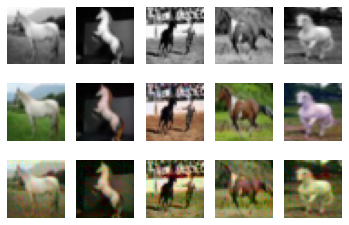

72 tensor(0.6928) tensor(1.3850)


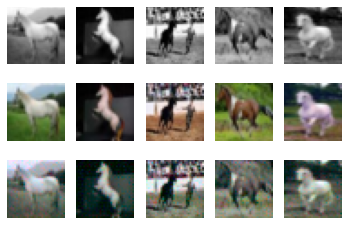

73 tensor(0.6932) tensor(1.3861)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 81 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


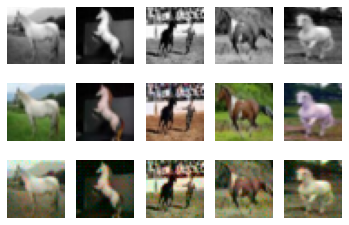

74 tensor(0.6927) tensor(1.3858)


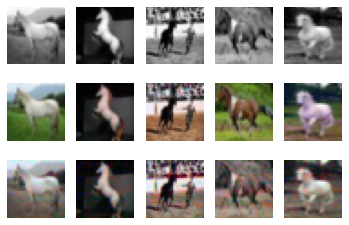

75 tensor(0.6918) tensor(1.3860)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 66 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


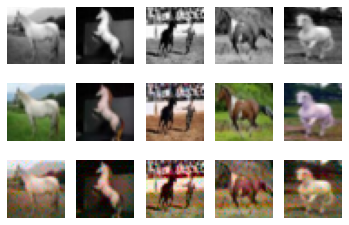

76 tensor(0.6934) tensor(1.3866)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 8 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


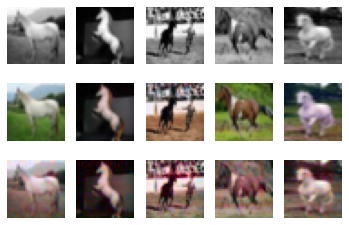

77 tensor(0.6939) tensor(1.3880)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 34 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


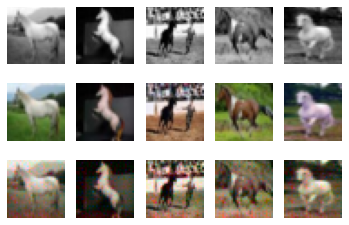

78 tensor(0.6928) tensor(1.3866)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 28 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


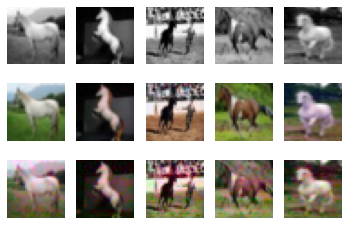

79 tensor(0.6930) tensor(1.3863)


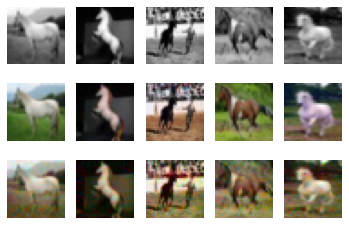

80 tensor(0.6932) tensor(1.3872)


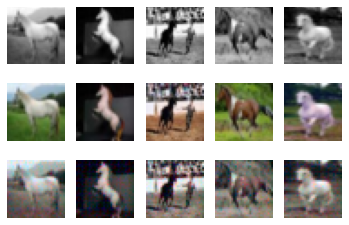

81 tensor(0.6927) tensor(1.3881)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 11 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


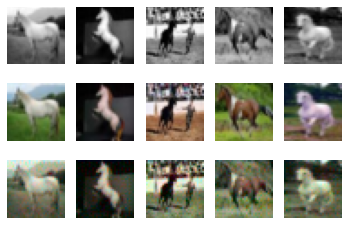

82 tensor(0.6936) tensor(1.3855)


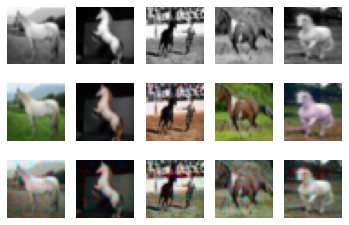

83 tensor(0.6935) tensor(1.3847)


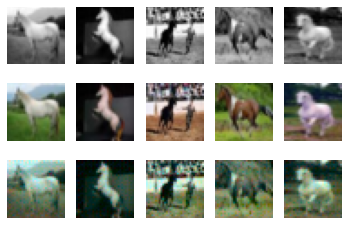

84 tensor(0.6922) tensor(1.3865)


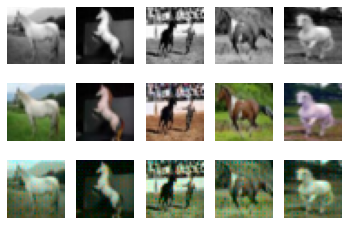

85 tensor(0.6926) tensor(1.3862)


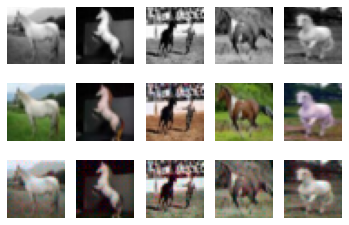

86 tensor(0.6931) tensor(1.3852)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 22 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


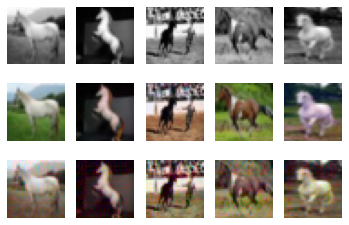

87 tensor(0.6934) tensor(1.3872)


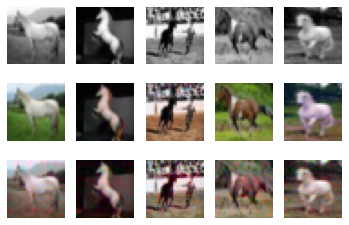

88 tensor(0.6929) tensor(1.3863)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 14 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


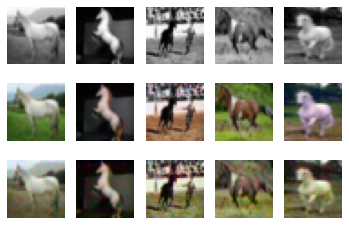

89 tensor(0.6924) tensor(1.3881)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 12 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


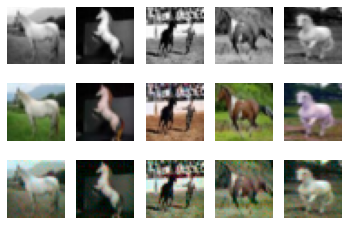

90 tensor(0.6923) tensor(1.3874)


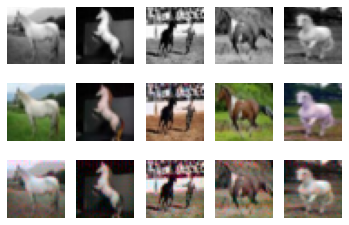

91 tensor(0.6932) tensor(1.3855)


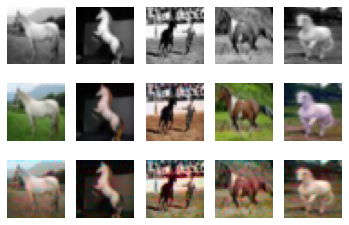

92 tensor(0.6923) tensor(1.3863)


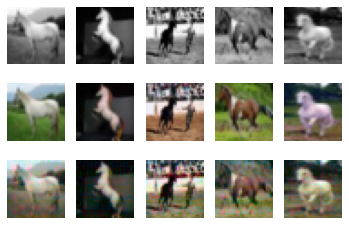

93 tensor(0.6928) tensor(1.3862)


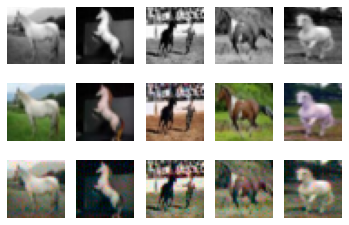

94 tensor(0.6934) tensor(1.3863)


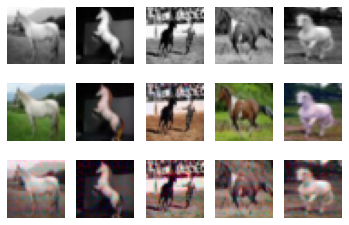

95 tensor(0.6934) tensor(1.3879)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 80 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


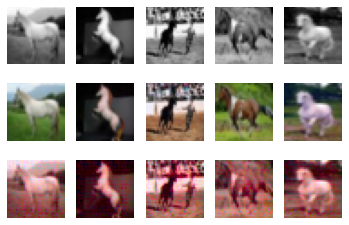

96 tensor(0.6930) tensor(1.3864)


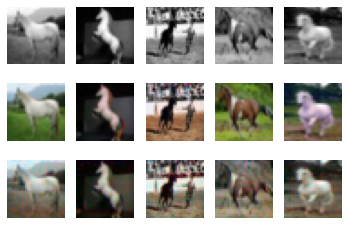

97 tensor(0.6933) tensor(1.3855)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 173 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


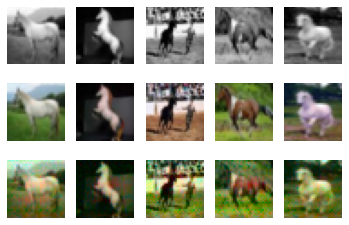

98 tensor(0.6934) tensor(1.3873)


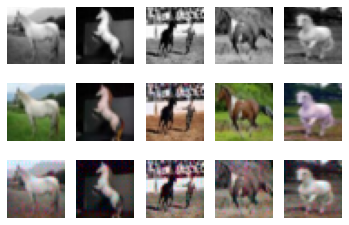

99 tensor(0.6921) tensor(1.3855)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 93 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


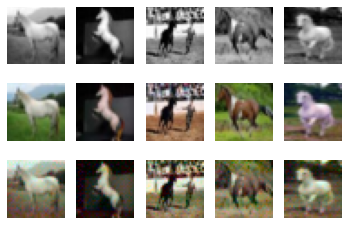

100 tensor(0.6932) tensor(1.3872)


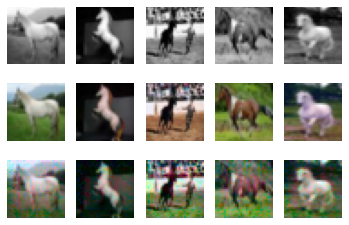

101 tensor(0.6916) tensor(1.3865)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 155 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


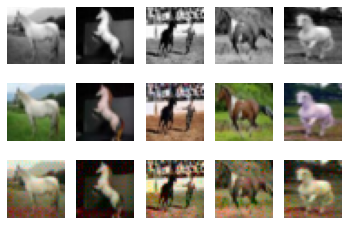

102 tensor(0.6930) tensor(1.3869)


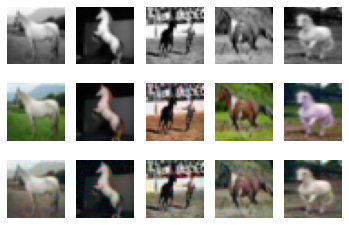

103 tensor(0.6937) tensor(1.3864)


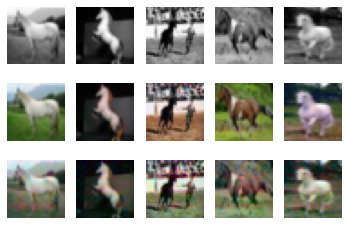

104 tensor(0.6941) tensor(1.3866)


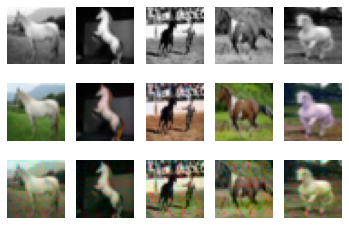

105 tensor(0.6930) tensor(1.3866)


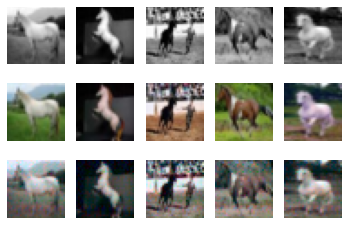

106 tensor(0.6928) tensor(1.3862)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 24 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


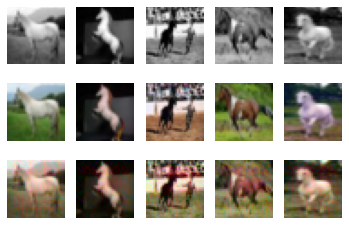

107 tensor(0.6933) tensor(1.3870)


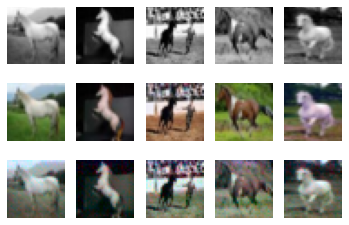

108 tensor(0.6924) tensor(1.3869)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 156 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


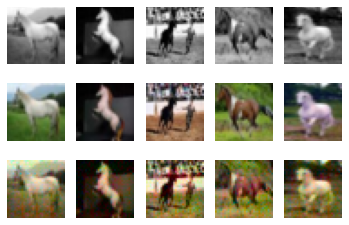

109 tensor(0.6928) tensor(1.3869)


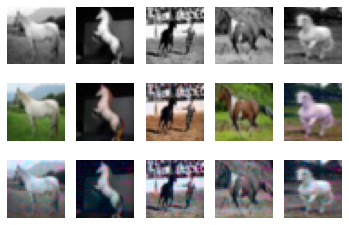

110 tensor(0.6926) tensor(1.3858)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 396 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


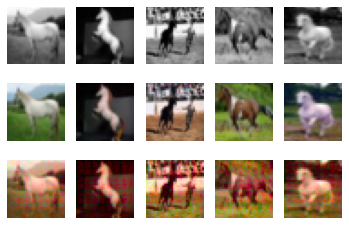

111 tensor(0.6931) tensor(1.3851)


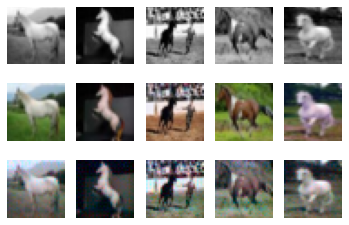

112 tensor(0.6931) tensor(1.3875)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 38 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


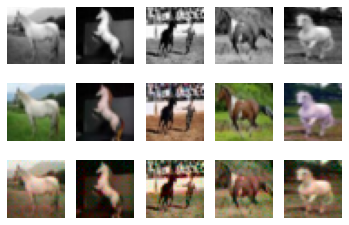

113 tensor(0.6933) tensor(1.3870)


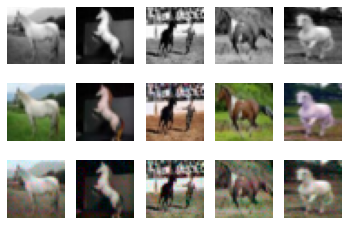

114 tensor(0.6938) tensor(1.3871)


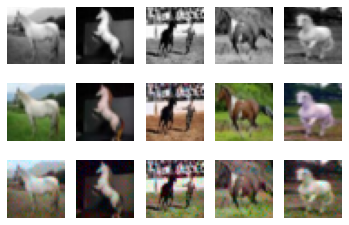

115 tensor(0.6919) tensor(1.3868)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 53 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


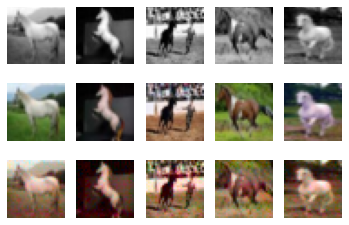

116 tensor(0.6935) tensor(1.3863)


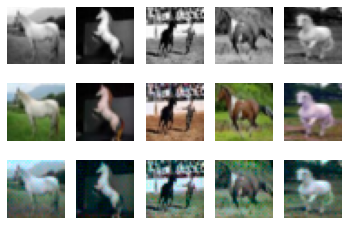

117 tensor(0.6937) tensor(1.3863)


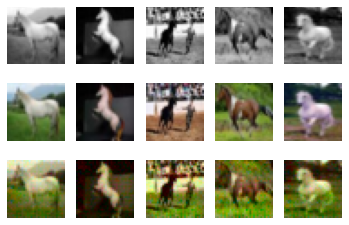

118 tensor(0.6930) tensor(1.3872)


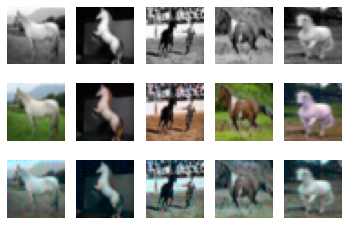

119 tensor(0.6931) tensor(1.3865)


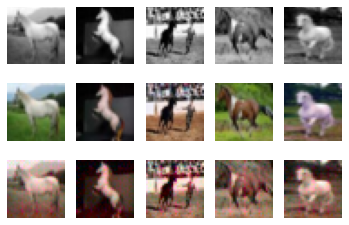

120 tensor(0.6940) tensor(1.3870)


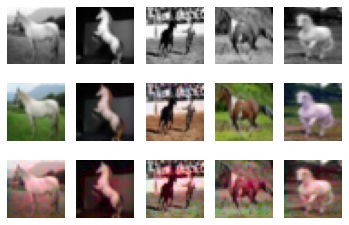

121 tensor(0.6933) tensor(1.3861)


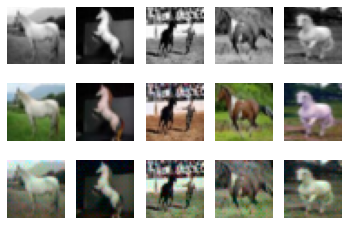

122 tensor(0.6921) tensor(1.3860)


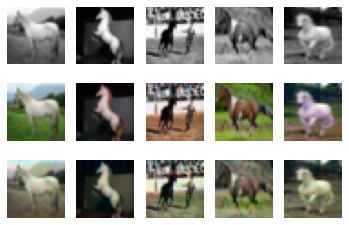

123 tensor(0.6927) tensor(1.3866)


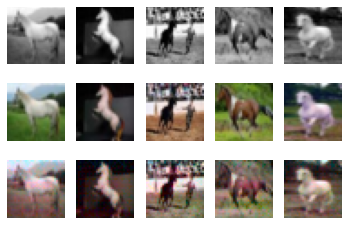

124 tensor(0.6938) tensor(1.3860)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 79 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


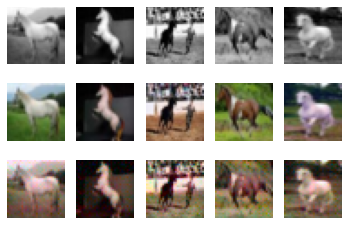

125 tensor(0.6935) tensor(1.3868)


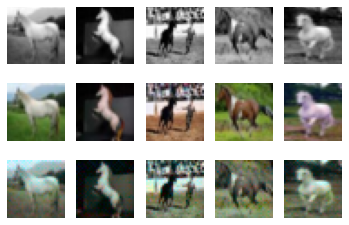

126 tensor(0.6932) tensor(1.3852)


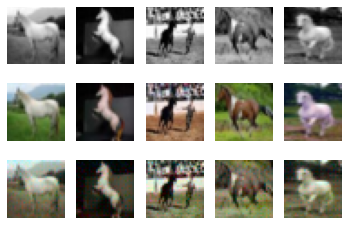

127 tensor(0.6931) tensor(1.3857)


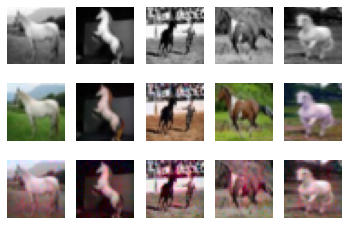

128 tensor(0.6928) tensor(1.3864)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 49 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


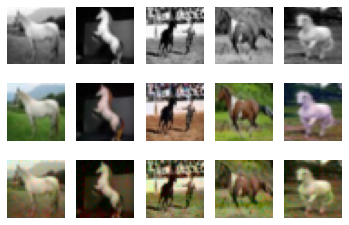

129 tensor(0.6929) tensor(1.3860)


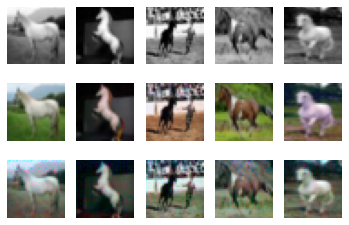

130 tensor(0.6932) tensor(1.3866)


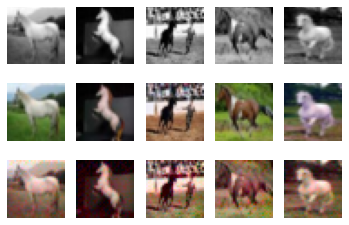

131 tensor(0.6930) tensor(1.3858)


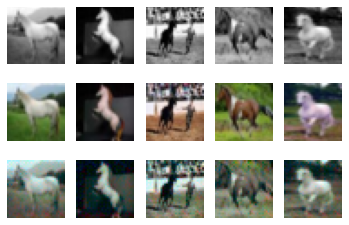

132 tensor(0.6935) tensor(1.3870)


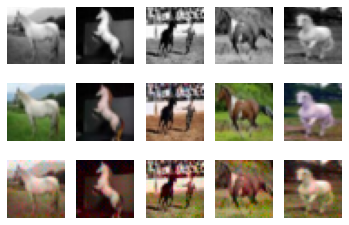

133 tensor(0.6940) tensor(1.3865)


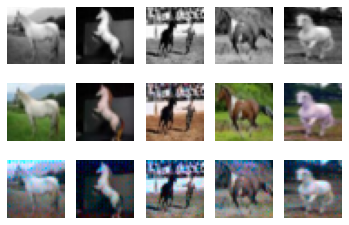

134 tensor(0.6929) tensor(1.3851)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 29 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


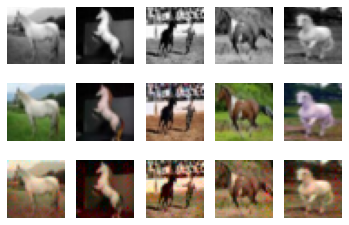

135 tensor(0.6927) tensor(1.3860)


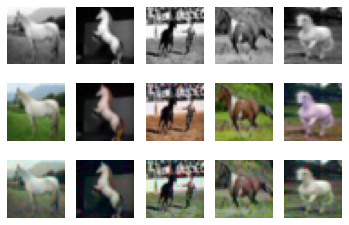

136 tensor(0.6943) tensor(1.3867)


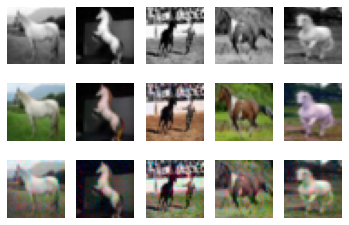

137 tensor(0.6932) tensor(1.3865)


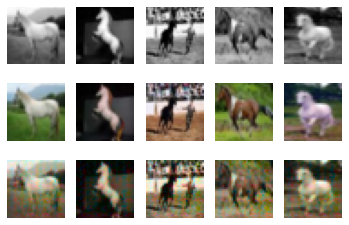

138 tensor(0.6926) tensor(1.3864)


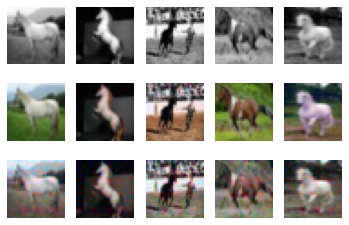

139 tensor(0.6936) tensor(1.3864)


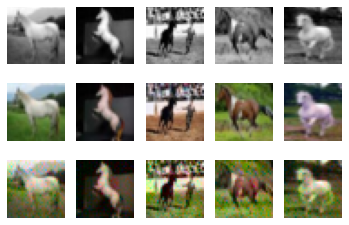

140 tensor(0.6934) tensor(1.3865)


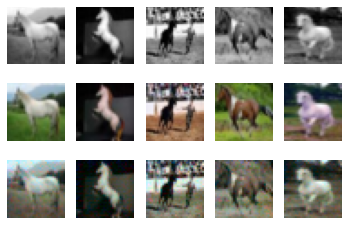

141 tensor(0.6923) tensor(1.3866)


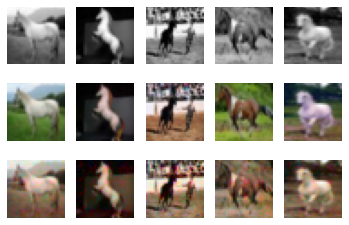

142 tensor(0.6928) tensor(1.3867)


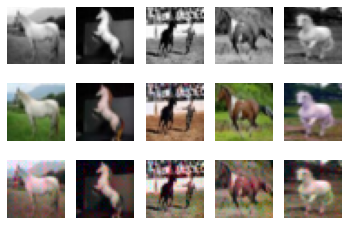

143 tensor(0.6929) tensor(1.3862)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 35 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


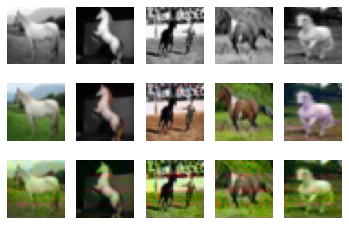

144 tensor(0.6924) tensor(1.3861)


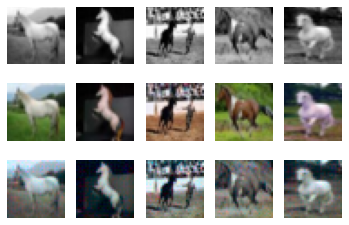

145 tensor(0.6931) tensor(1.3867)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 23 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


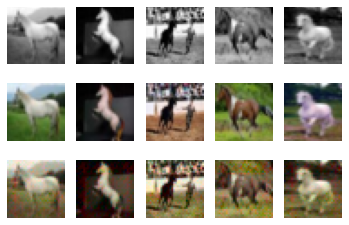

146 tensor(0.6926) tensor(1.3864)


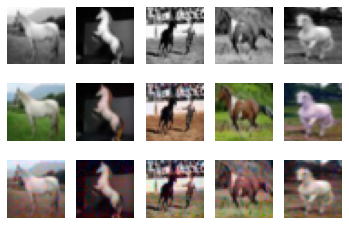

147 tensor(0.6929) tensor(1.3882)


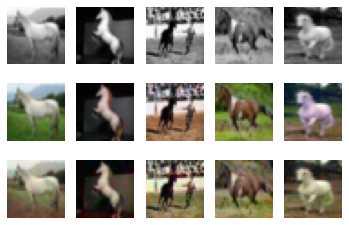

148 tensor(0.6926) tensor(1.3864)


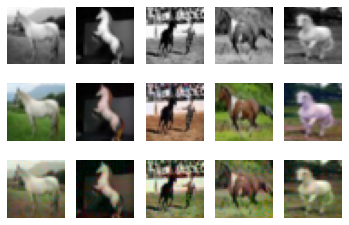

149 tensor(0.6929) tensor(1.3868)


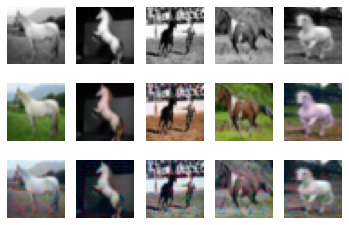

150 tensor(0.6932) tensor(1.3877)


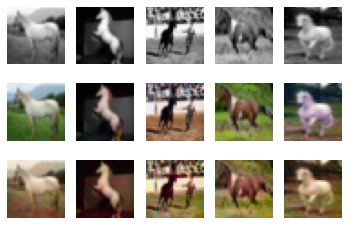

151 tensor(0.6921) tensor(1.3850)


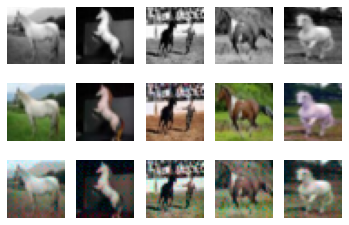

152 tensor(0.6930) tensor(1.3872)


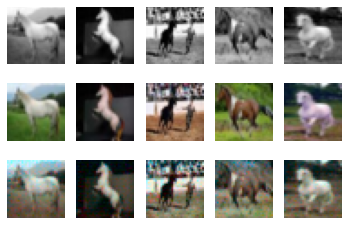

153 tensor(0.6919) tensor(1.3867)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 32 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


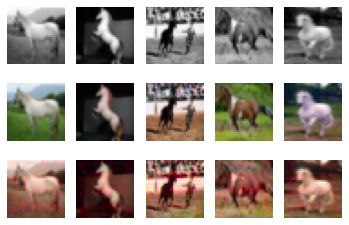

154 tensor(0.6925) tensor(1.3851)


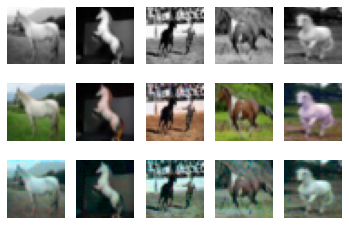

155 tensor(0.6918) tensor(1.3872)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 13 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


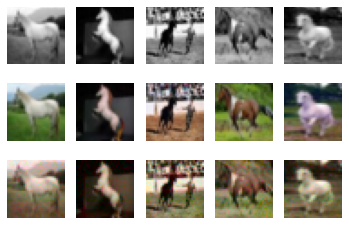

156 tensor(0.6926) tensor(1.3876)


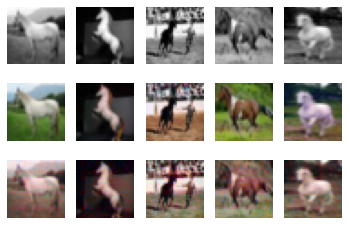

157 tensor(0.6930) tensor(1.3874)


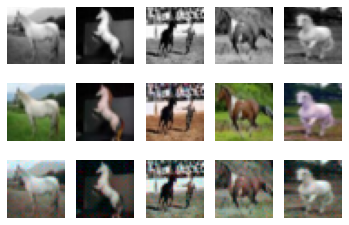

158 tensor(0.6933) tensor(1.3877)


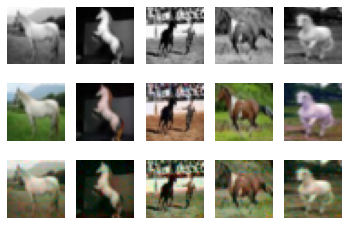

159 tensor(0.6928) tensor(1.3871)


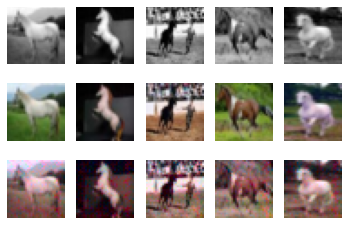

In [ ]:
args = AttrDict()
args_dict = {
    "gpu": True,
    "valid": False,
    "checkpoint": "",
    "colours": "./data/colours/colour_kmeans24_cat7.npy",
    "model": "Generator_lab",
    "kernel": 3,
    "num_filters": 32,
    'learn_rate':0.001, 
    "batch_size": 50,
    "epochs": 160,
    "seed": 1,
    "plot": False,
    "experiment_name": "colourization_gan_lab",
    "visualize": False,
    "downsize_input": False,
}
args.update(args_dict)
cnn = train_gan_lab(args)

Epochs with decent output quality: 87, 96, 113, 138


## Test on New Data
Retrieve sample pictures from online

In [ ]:
#this part the model is tested on validation set and greyscale images of horse from 
#kaggle https://www.kaggle.com/suyashdamle/cyclegan
g_net=Generator_lab(kernel=3, num_filters=32)
d_net=Discriminator_lab(kernel=3, num_filters=32)
model_path_eval_g = get_model_name('Generator_lab', epoch=138)
model_path_eval_d = get_model_name('discriminator_lab', epoch=138)
state_1 = torch.load(model_path_eval_g)
g_net.load_state_dict(state_1)
state_2 = torch.load(model_path_eval_d)
d_net.load_state_dict(state_2)

<All keys matched successfully>

In [ ]:
(x_train, y_train), (x_test, y_test) = load_cifar10()

test_ab, test_grey = process_lab(x_test, y_test, downsize_input=args.downsize_input)

File path: data/cifar-10-batches-py.tar.gz


In [ ]:
def evaluate_lab(gen,dis,test_grey, test_ab):
    total_loss_d = 0.0
    total_loss_g = 0.0
    total_accuracy = 0.0
    total_epoch = 0
    criterion = nn.BCELoss()
    for i, (xs, ys) in enumerate(get_batch_lab(test_grey, test_ab,50)):
      images, lab = get_torch_vars(xs, ys)
      img_grey = images
      img_real = lab
      batch_size = 50
      
      fake_images = gen(img_grey)
      fake_validity = dis(fake_images, img_grey)
      fake_loss = criterion(fake_validity, Variable(torch.zeros(batch_size)))
      real_validity = dis(img_real, img_grey)
      real_loss = criterion(real_validity, Variable(torch.ones(batch_size)))   
      d_loss = real_loss + fake_loss

      g_loss = criterion(fake_validity, Variable(torch.ones(batch_size)))
      
      total_loss_d += d_loss.item()
      total_loss_g += g_loss.item()

    loss_d = float(total_loss_d) / (i + 1)
    loss_g = float(total_loss_g) / (i + 1)
    img_grey = img_grey.cpu().detach().numpy()
    img_lab = img_real.cpu().detach().numpy()
    img_fake = fake_images.cpu().detach().numpy()
    pic_1 = np.zeros((batch_size,3,32,32))
    pic_1[:,0:1,:,:]=(img_grey+1.)*50.
    pic_1[:,1:3,:,:]=img_lab*110.
    img_real=lab2rgb(np.transpose(pic_1,[0,2,3,1]))
    pic_2 = np.zeros((batch_size,3,32,32))
    pic_2[:,0:1,:,:]=(img_grey+1.)*50.
    pic_2[:,1:3,:,:]=img_fake*110.
    img_fake=lab2rgb(np.transpose(pic_2,[0,2,3,1]))
    #correct image structure
    img_grey = np.transpose(img_grey[:5, :, :, :], [0, 2, 3, 1]).squeeze()
    img_real = img_real[:5, :, :, :]
    img_fake = img_fake[:5, :, :, :]
    for i in range(5):
      ax = plt.subplot(3, 5, i + 1)
      ax.imshow(img_grey[i], cmap='gray')
      ax.axis("off")
      ax = plt.subplot(3, 5, i + 1 + 5)
      ax.imshow(img_real[i])
      ax.axis("off")
      ax = plt.subplot(3, 5, i + 1 + 10)
      ax.imshow(img_fake[i])
      ax.axis("off")
    plt.show()

    return loss_d, loss_g


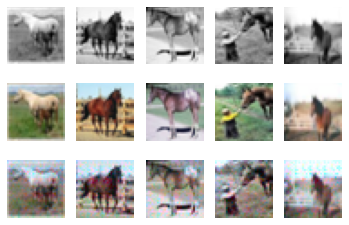

In [ ]:
loss_d, loss_g =evaluate_lab(g_net,d_net,test_grey, test_ab)

In [ ]:
print('Loss_d:',loss_d)
print('Loss_g:',loss_g)

Loss_d: 1.3860849678516387
Loss_g: 0.6931809574365616


In [ ]:
from torchvision import datasets, transforms
from zipfile import ZipFile

with ZipFile('Horse_data_new.zip', 'r') as zipObj:
   zipObj.extractall() 

In [ ]:
import glob
from PIL import Image 
images_h = []
for f in glob.iglob("Horse_data_new/Horse/*"):
    images_h.append(np.asarray(Image.open(f).resize((32,32))))

data_horse = np.array(images_h)

In [ ]:
def process_lab_new(xs, downsize_input=False):

    npr.shuffle(xs)
    lab = rgb2lab(xs)
    l = lab[:,:,:,0:1] / 50. - 1.
    ab = lab[:,:,:,1:3] / 110.
    l = np.transpose(l,[0,3,1,2])
    ab = np.transpose(ab,[0,3,1,2])
    return (ab, l)

In [ ]:
test_lab, test_g = process_lab_new(data_horse)

/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 4 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


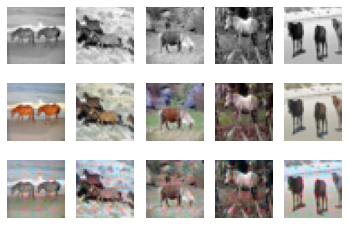

In [ ]:
loss_d1, loss_g1 =evaluate_lab(g_net,d_net,test_g, test_lab)